In [427]:
import numpy as np
import math
import pandas as pd

import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

from scipy.integrate import solve_ivp
from scipy.interpolate import Rbf
from skimage.measure import marching_cubes
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline

from torchmetrics import Accuracy
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

from lion_pytorch import Lion

from tqdm import tqdm

from copy import deepcopy

import warnings
warnings.filterwarnings("ignore")

We consider three-population competition model:
\begin{align*}
    &\frac{dx}{dt}=(1-\frac{x}{3})x-5xy-4xz\\
    &\frac{dy}{dt}=2(1-\frac{y}{2})y-3xy-7yz\\
    &\frac{dz}{dt}=2(1-z)z-7xz-10yz
\end{align*}

There are three attractors: $(3,0,0),(0,2,0)$ and $(0,0,1)$. The other equilibria, $(0,0,0)$, $(0, \frac{5}{34}, \frac{9}{34}), (\frac{162}{853}, \frac{23}{853}, \frac{171}{853}), (\frac{9}{41},0,\frac{19}{82}),$ $(\frac{27}{44},\frac{7}{44}, 0)$ are either unstable equilibrium or saddle points.

We consider the domain of $[0,4] \times [0,4] \times [0,4]$ and estimate the basin of attraction of $(0,2,0).$

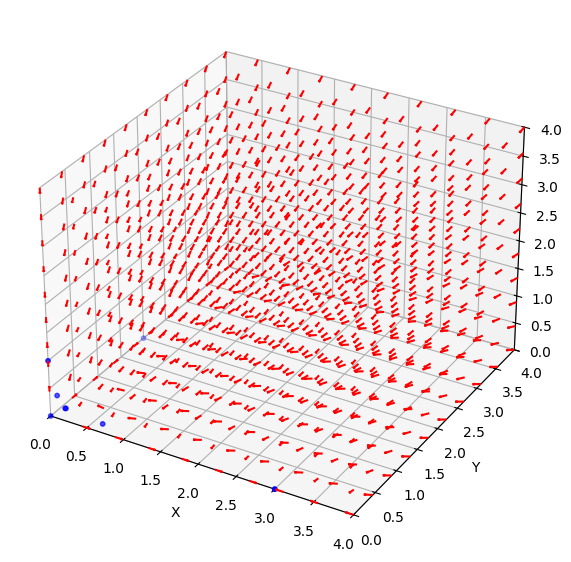

In [2]:
def system(t, X):
    x, y, z = X
    xp = (1-x/3)*x - 5*x*y - 4*x*z
    yp = 2*(1-y/2)*y - 3*x*y - 7*y*z
    zp = 2*(1-z)*z - 7*x*z - 10*y*z
    return xp, yp, zp

# Create a grid of points
x = np.linspace(0, 4, 10)
y = np.linspace(0, 4, 10)
z = np.linspace(0, 4, 10)
X, Y, Z = np.meshgrid(x, y, z)

# Compute the vector field
U, V, W = np.zeros(X.shape), np.zeros(Y.shape), np.zeros(Z.shape)
for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        for k in range(X.shape[2]):
            xp, yp, zp = system(0, (X[i, j, k], Y[i, j, k], Z[i, j, k]))
            U[i, j, k], V[i, j, k], W[i, j, k] = xp, yp, zp

# Plot the vector field
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
ax.quiver(X, Y, Z, U, V, W, length=0.1, normalize=True, color='red')
ax.scatter([3,0,0,0,0,162/853,9/41,27/44], [0,2,0,0,5/34,23/853,0,7/44], [0,0,1,0,9/34,171/853,19/82,0], color='blue', s=10)

ax.set_xlim([0, 4])
ax.set_ylim([0, 4])
ax.set_zlim([0, 4])
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

In [3]:
def euclidean_distance(point1, point2):
    point1, point2 = np.array(point1), np.array(point2)
    return np.sqrt(np.sum((point1 - point2) ** 2))

attractor = [0, 2, 0]

def is_attracted(x, y, z):
    return euclidean_distance((x, y, z), attractor) < 1e-3

def simulation(x0 ,y0 ,z0):
    tmax, n = 1500, 100000
    soln = solve_ivp(system, (0, tmax), (x0, y0, z0),dense_output=True, rtol=1e-10, atol=1e-10)
    t = np.linspace(0, tmax, n)
    x, y, z = soln.sol(t)
    return is_attracted(x[n-1], y[n-1], z[n-1])

def bisection(a, b, delta=0.04): ## a has label +1 and b has label -1
    distance = np.linalg.norm(np.array([a[0]-b[0], a[1]-b[1], a[2]-b[2]]))
    if distance < delta:
        return (a, b)
    else:
        c = ((a[0]+b[0])/2, (a[1]+b[1])/2, (a[2]+b[2])/2)
        if simulation(c[0], c[1], c[2]):
            return bisection(c, b, delta)
        else:
            return bisection(a, c, delta)

In [4]:
simulation(0, 3.9, 0)

True

In [6]:
## Generate 15,000 uniformly sampled points in the square [-2, 2] x [-2, 2]
np.random.seed(0)
X = np.random.uniform(0, 4, 15000)
Y = np.random.uniform(0, 4, 15000)
Z = np.random.uniform(0, 4, 15000)

# Create the dataset
df = pd.DataFrame(columns=['x0', 'y0', 'z0', 'attracted'])
for i in tqdm(range(15000)):  # wrap range with tqdm for progress bar
    x0, y0, z0 = X[i], Y[i], Z[i]
    attracted_result = simulation(x0, y0, z0)
    attracted_result = 1 if attracted_result else -1  # map True to 1 and False to -1
    df.loc[i] = [x0, y0, z0, attracted_result]

# Save the DataFrame to a CSV file
df.to_csv('dataset_threepop_general_15000.csv', index=False)

100%|██████████| 15000/15000 [1:14:26<00:00,  3.36it/s]


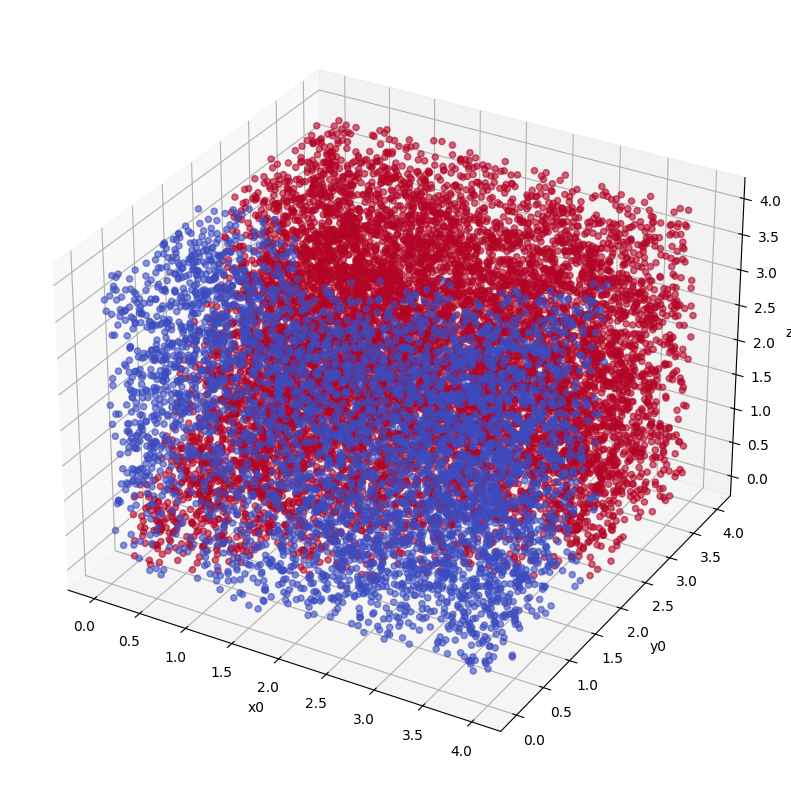

In [5]:
df = pd.read_csv('dataset_threepop_general_15000.csv')

# Prepare the figure and 3D axis
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using x0, y0, z0 as coordinates
# Color by 'attracted': map the 'attracted' column to colors
scatter = ax.scatter(df['x0'], df['y0'], df['z0'], c=df['attracted'], cmap='coolwarm', alpha=0.6)


# Labels
ax.set_xlabel('x0')
ax.set_ylabel('y0')
ax.set_zlabel('z0')

# Show plot
plt.show()

In [8]:
df_data = pd.read_csv('dataset_threepop_general_15000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(40)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(40)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'], df_data_1.iloc[i]['z0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'], df_data_n1.iloc[j]['z0'])
        a, b = bisection(a, b, delta=0.01)
        dataset_near.append([a[0], a[1], a[2], 1])
        dataset_near.append([b[0], b[1], b[2], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'z0', 'attracted'])
df_near.to_csv('dataset_threepop_near_3200_0.01.csv', index=False)

Processing df_1: 100%|██████████| 40/40 [1:07:38<00:00, 101.46s/it]


In [9]:
df_data = pd.read_csv('dataset_threepop_general_15000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(40)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(40)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'], df_data_1.iloc[i]['z0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'], df_data_n1.iloc[j]['z0'])
        a, b = bisection(a, b, delta=0.02)
        dataset_near.append([a[0], a[1], a[2], 1])
        dataset_near.append([b[0], b[1], b[2], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'z0', 'attracted'])
df_near.to_csv('dataset_threepop_near_3200_0.02.csv', index=False)

Processing df_1: 100%|██████████| 40/40 [1:01:24<00:00, 92.10s/it]


In [10]:
df_data = pd.read_csv('dataset_threepop_general_15000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(40)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(40)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'], df_data_1.iloc[i]['z0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'], df_data_n1.iloc[j]['z0'])
        a, b = bisection(a, b, delta=0.03)
        dataset_near.append([a[0], a[1], a[2], 1])
        dataset_near.append([b[0], b[1], b[2], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'z0', 'attracted'])
df_near.to_csv('dataset_threepop_near_3200_0.03.csv', index=False)

Processing df_1: 100%|██████████| 40/40 [53:50<00:00, 80.77s/it]


In [11]:
df_data = pd.read_csv('dataset_threepop_general_15000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(40)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(40)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'], df_data_1.iloc[i]['z0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'], df_data_n1.iloc[j]['z0'])
        a, b = bisection(a, b, delta=0.04)
        dataset_near.append([a[0], a[1], a[2], 1])
        dataset_near.append([b[0], b[1], b[2], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'z0', 'attracted'])
df_near.to_csv('dataset_threepop_near_3200_0.04.csv', index=False)

Processing df_1: 100%|██████████| 40/40 [52:07<00:00, 78.19s/it]


In [12]:
df_data = pd.read_csv('dataset_threepop_general_15000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(40)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(40)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'], df_data_1.iloc[i]['z0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'], df_data_n1.iloc[j]['z0'])
        a, b = bisection(a, b, delta=0.05)
        dataset_near.append([a[0], a[1], a[2], 1])
        dataset_near.append([b[0], b[1], b[2], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'z0', 'attracted'])
df_near.to_csv('dataset_threepop_near_3200_0.05.csv', index=False)

Processing df_1: 100%|██████████| 40/40 [52:32<00:00, 78.80s/it]


In [13]:
df_data = pd.read_csv('dataset_threepop_general_15000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(40)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(40)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'], df_data_1.iloc[i]['z0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'], df_data_n1.iloc[j]['z0'])
        a, b = bisection(a, b, delta=0.1)
        dataset_near.append([a[0], a[1], a[2], 1])
        dataset_near.append([b[0], b[1], b[2], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'z0', 'attracted'])
df_near.to_csv('dataset_threepop_near_3200_0.1.csv', index=False)

Processing df_1: 100%|██████████| 40/40 [42:33<00:00, 63.85s/it]


In [7]:
class SystemDataset(Dataset):
    def __init__(self, csv_file):
        self.data = pd.read_csv(csv_file)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        x = torch.from_numpy(self.data.iloc[idx, 0:3].values).float()
        y = torch.tensor(self.data.iloc[idx, 3]).float()
        return x, y

In [8]:
'''
dataset_train: uniformly sampled 200 points
dataset_validation_uniform: uniformly sampled 1,000 points
dataset_test_uniform: uniformly sampled 1,000 points
dataset_validation_near: 1,000 points near the boundary
dataset_test_near: 1,000 points near the boundary
Each dataset above are mutually independent
'''

df_uniform = pd.read_csv('dataset_threepop_general_15000.csv')
df_uniform_train = df_uniform.sample(n=200)
remaining_df = df_uniform.drop(df_uniform_train.index)
df_uniform_validation = remaining_df.sample(n=1000)
remaining_df = remaining_df.drop(df_uniform_validation.index)
df_uniform_test = remaining_df.sample(n=1000)

df_001 = pd.read_csv('dataset_threepop_near_3200_0.01.csv')
df_001_validation = df_001.sample(n=1000)
remaining_df = df_001.drop(df_001_validation.index)
df_001_test = remaining_df.sample(n=1000)

df_002 = pd.read_csv('dataset_threepop_near_3200_0.02.csv')
df_002_validation = df_002.sample(n=1000)
remaining_df = df_002.drop(df_002_validation.index)
df_002_test = remaining_df.sample(n=1000)

df_003 = pd.read_csv('dataset_threepop_near_3200_0.03.csv')
df_003_validation = df_003.sample(n=1000)
remaining_df = df_003.drop(df_003_validation.index)
df_003_test = remaining_df.sample(n=1000)

df_004 = pd.read_csv('dataset_threepop_near_3200_0.04.csv')
df_004_validation = df_004.sample(n=1000)
remaining_df = df_004.drop(df_004_validation.index)
df_004_test = remaining_df.sample(n=1000)

df_005 = pd.read_csv('dataset_threepop_near_3200_0.05.csv')
df_005_validation = df_005.sample(n=1000)
remaining_df = df_005.drop(df_005_validation.index)
df_005_test = remaining_df.sample(n=1000)

df_010 = pd.read_csv('dataset_threepop_near_3200_0.1.csv')
df_010_validation = df_010.sample(n=1000)
remaining_df = df_010.drop(df_010_validation.index)
df_010_test = remaining_df.sample(n=1000)


dataset_train = SystemDataset('dataset_doublewell_general_100000.csv')
dataset_train.data = df_uniform_train

dataset_validation_uniform = SystemDataset('dataset_doublewell_general_100000.csv')
dataset_validation_uniform.data = df_uniform_validation

dataset_test_uniform = SystemDataset('dataset_doublewell_general_100000.csv')
dataset_test_uniform.data = df_uniform_test

dataset_validation_near_001 = SystemDataset('dataset_doublewell_near_5000_0.01.csv')
dataset_validation_near_001.data = df_001_validation
dataset_test_near_001 = SystemDataset('dataset_doublewell_near_5000_0.01.csv')
dataset_test_near_001.data = df_001_test

dataset_validation_near_002 = SystemDataset('dataset_doublewell_near_5000_0.02.csv')
dataset_validation_near_002.data = df_002_validation
dataset_test_near_002 = SystemDataset('dataset_doublewell_near_5000_0.02.csv')
dataset_test_near_002.data = df_002_test

dataset_validation_near_003 = SystemDataset('dataset_doublewell_near_5000_0.03.csv')
dataset_validation_near_003.data = df_003_validation
dataset_test_near_003 = SystemDataset('dataset_doublewell_near_5000_0.03.csv')
dataset_test_near_003.data = df_003_test

dataset_validation_near_004 = SystemDataset('dataset_doublewell_near_5000_0.04.csv')
dataset_validation_near_004.data = df_004_validation
dataset_test_near_004 = SystemDataset('dataset_doublewell_near_5000_0.04.csv')
dataset_test_near_004.data = df_004_test

dataset_validation_near_005 = SystemDataset('dataset_doublewell_near_5000_0.05.csv')
dataset_validation_near_005.data = df_005_validation
dataset_test_near_005 = SystemDataset('dataset_doublewell_near_5000_0.05.csv')
dataset_test_near_005.data = df_005_test

dataset_validation_near_010 = SystemDataset('dataset_doublewell_near_5000_0.1.csv')
dataset_validation_near_010.data = df_010_validation
dataset_test_near_010 = SystemDataset('dataset_doublewell_near_5000_0.1.csv')
dataset_test_near_010.data = df_010_test

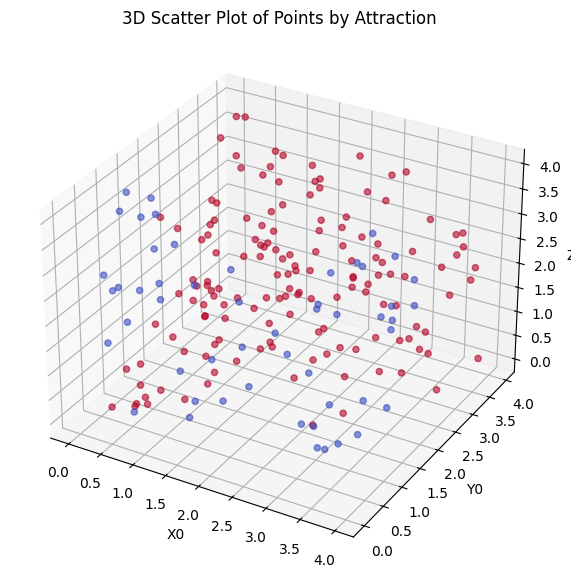

In [9]:
df = df_uniform_train

# Prepare the figure and 3D axis
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using x0, y0, z0 as coordinates
# Color by 'attracted': map the 'attracted' column to colors
scatter = ax.scatter(df['x0'], df['y0'], df['z0'], c=df['attracted'], cmap='coolwarm', alpha=0.6)


# Labels
ax.set_xlabel('X0')
ax.set_ylabel('Y0')
ax.set_zlabel('Z0')
ax.set_title('3D Scatter Plot of Points by Attraction')

# Show plot
plt.show()

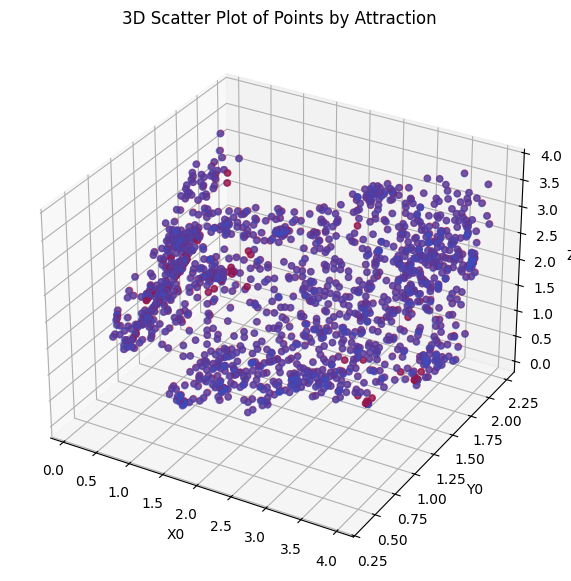

In [10]:
df = df_001
# Prepare the figure and 3D axis
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using x0, y0, z0 as coordinates
# Color by 'attracted': map the 'attracted' column to colors
scatter = ax.scatter(df['x0'], df['y0'], df['z0'], c=df['attracted'], cmap='coolwarm', alpha=0.6)


# Labels
ax.set_xlabel('X0')
ax.set_ylabel('Y0')
ax.set_zlabel('Z0')
ax.set_title('3D Scatter Plot of Points by Attraction')

# Show plot
plt.show()

In [11]:
## Define the neural network. The complexity of the network is a hyperparameter.
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(3, 16)
        self.fc2 = nn.Linear(16, 16)
        self.fc3 = nn.Linear(16, 1)

        #self.bn1 = nn.BatchNorm1d(32)
        #self.bn2 = nn.BatchNorm1d(32)
        #self.bn3 = nn.BatchNorm1d(32)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        #x = self.bn1(x)
        x = torch.relu(self.fc2(x))
        #x = self.bn2(x)
        x = self.fc3(x)
        #x = self.bn3(x)
        return x

In [507]:
def train_model_bce(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002, dataset_validation003,
                    dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = nn.BCEWithLogitsLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)
    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []

    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = (outputs > 0).float()
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss = criterion(outputs, labels)
            avg_loss_train += loss.item()
            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy, 
                                      'Validation1 Accuracy': validation1_accuracy, 
                                      'Validation001 Accuracy': validation001_accuracy, 
                                      'Validation002 Accuracy': validation002_accuracy, 
                                      'Validation003 Accuracy': validation003_accuracy, 
                                      'Validation004 Accuracy': validation004_accuracy, 
                                      'Validation005 Accuracy': validation005_accuracy, 
                                      'Validation010 Accuracy': validation010_accuracy})
        
        # Plot the decision boundary after each 20% of the epochs
        if (epoch + 1) % (epochs // 5) == 0:
            plot_contour(net)
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    
    #test_model(net, dataset_train)
    #test_model(net, dataset_validation001)
    #test_model(net, dataset_validation002)
    #test_model(net, dataset_validation003)
    #test_model(net, dataset_validation004)
    #test_model(net, dataset_validation005)
    #test_model(net, dataset_validation010)

In [13]:
def test_model(net, dataset_test):
    net.eval()
    dataloader_test = DataLoader(dataset_test, batch_size=32, shuffle=False)
    features_list = []
    labels_list = []
    probability_list = []
    predictions_list = []
    acc = Accuracy(task = 'binary')

    with torch.no_grad():
        for features, labels in dataloader_test:
            labels = ((labels + 1) / 2).float()
            probability = net(features)
            outputs = (probability > 0).float()
            outputs = outputs.squeeze()

            acc.update(outputs, labels)

            features_list.append(features.numpy())
            labels_list.append(labels.numpy())
            probability_list.append(probability.numpy())
            predictions_list.append(outputs.numpy())
    accuracy = acc.compute()
    print(f'Accuracy: {accuracy}')

    # Concatenate all batches
    features = np.concatenate(features_list, axis=0)
    labels = np.concatenate(labels_list, axis=0)
    probability = np.concatenate(probability_list, axis=0)
    predictions = np.concatenate(predictions_list, axis=0)

    # Create a 3D scatter plot
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')

    # Plot the features colored by the predictions
    scatter = ax.scatter(features[:, 0], features[:, 1], features[:, 2], c=probability, cmap='coolwarm', vmin=-np.max(np.abs(probability)), vmax=np.max(np.abs(probability)))

    plt.colorbar(scatter)

    plt.show()

    plt.hist(probability, bins=20)
    plt.show()
    return accuracy

Overall Training Progress:  20%|██        | 240/1200 [01:16<05:05,  3.14it/s, Training Accuracy=0.87, Validation1 Accuracy=0.896, Validation001 Accuracy=0.517, Validation002 Accuracy=0.49, Validation003 Accuracy=0.502, Validation004 Accuracy=0.505, Validation005 Accuracy=0.507, Validation010 Accuracy=0.507]  

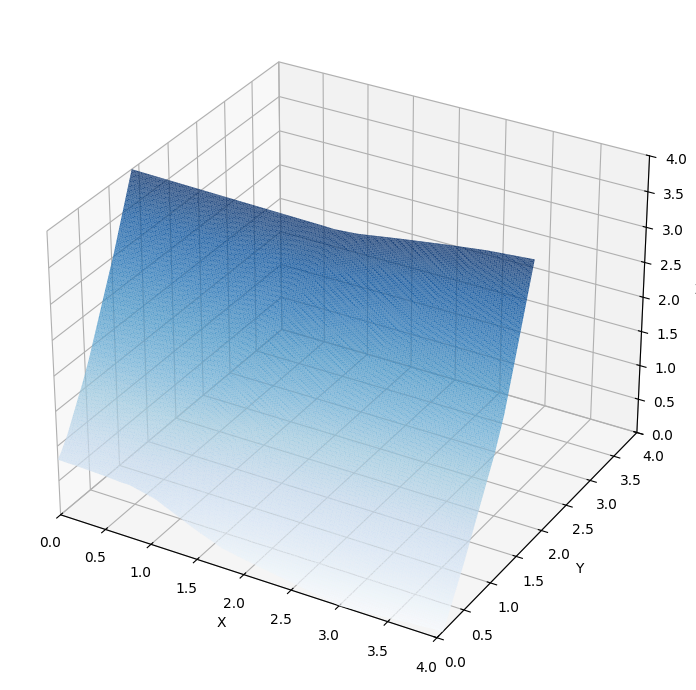

Overall Training Progress:  40%|████      | 480/1200 [02:36<03:44,  3.20it/s, Training Accuracy=0.965, Validation1 Accuracy=0.965, Validation001 Accuracy=0.517, Validation002 Accuracy=0.492, Validation003 Accuracy=0.53, Validation004 Accuracy=0.486, Validation005 Accuracy=0.484, Validation010 Accuracy=0.546] 

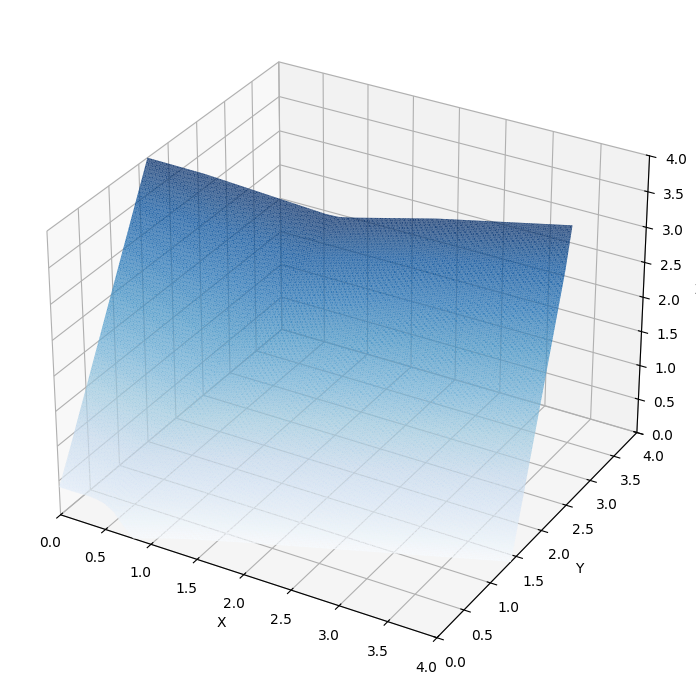

Overall Training Progress:  60%|██████    | 720/1200 [03:54<02:32,  3.15it/s, Training Accuracy=0.995, Validation1 Accuracy=0.989, Validation001 Accuracy=0.519, Validation002 Accuracy=0.519, Validation003 Accuracy=0.504, Validation004 Accuracy=0.522, Validation005 Accuracy=0.519, Validation010 Accuracy=0.586]

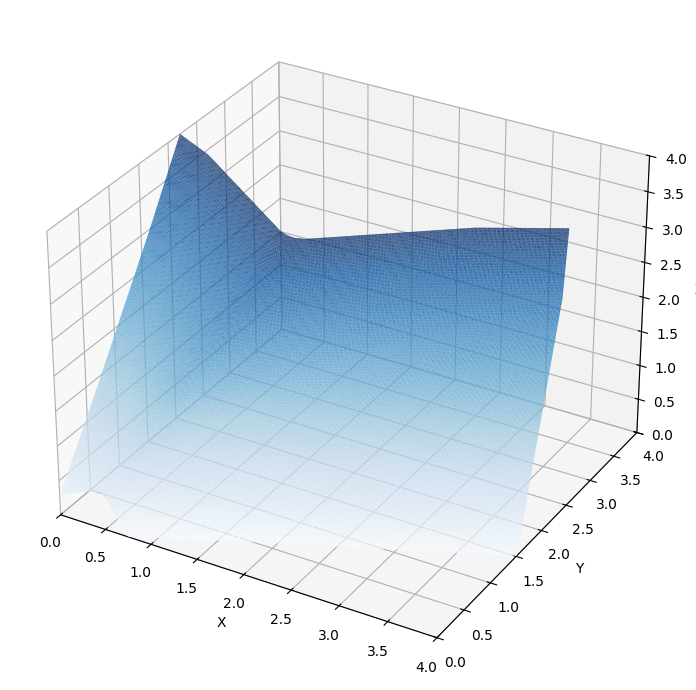

Overall Training Progress:  80%|████████  | 960/1200 [05:13<01:14,  3.24it/s, Training Accuracy=1, Validation1 Accuracy=0.983, Validation001 Accuracy=0.505, Validation002 Accuracy=0.514, Validation003 Accuracy=0.529, Validation004 Accuracy=0.574, Validation005 Accuracy=0.518, Validation010 Accuracy=0.599]    

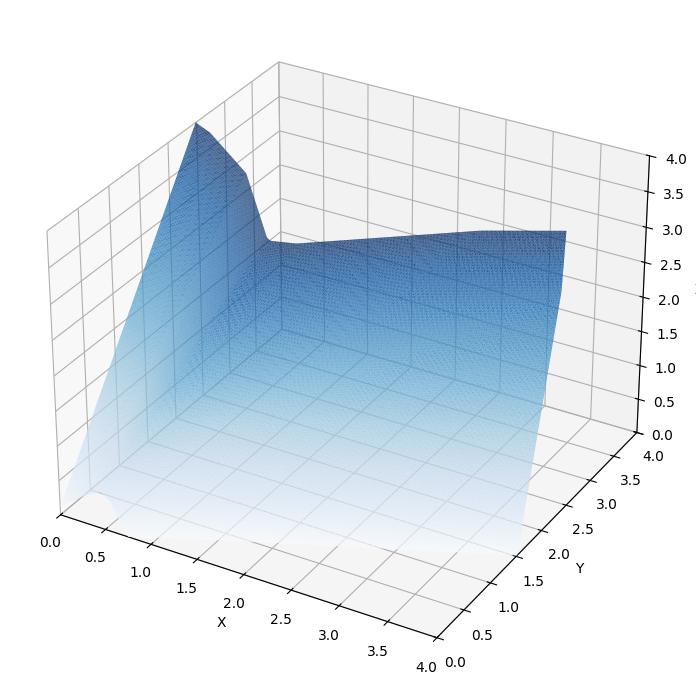

Overall Training Progress: 100%|██████████| 1200/1200 [06:32<00:00,  3.23it/s, Training Accuracy=1, Validation1 Accuracy=0.979, Validation001 Accuracy=0.501, Validation002 Accuracy=0.519, Validation003 Accuracy=0.519, Validation004 Accuracy=0.529, Validation005 Accuracy=0.514, Validation010 Accuracy=0.588]

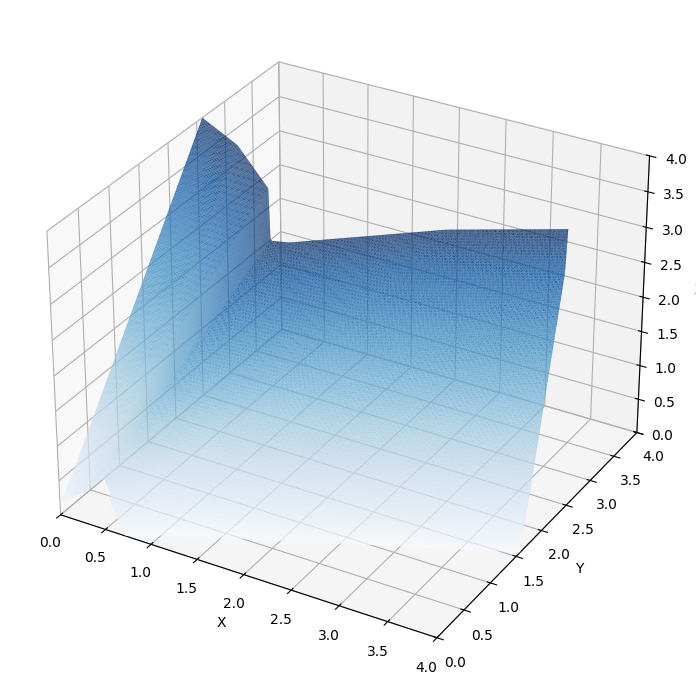

Overall Training Progress: 100%|██████████| 1200/1200 [06:36<00:00,  3.03it/s, Training Accuracy=1, Validation1 Accuracy=0.979, Validation001 Accuracy=0.501, Validation002 Accuracy=0.519, Validation003 Accuracy=0.519, Validation004 Accuracy=0.529, Validation005 Accuracy=0.514, Validation010 Accuracy=0.588]


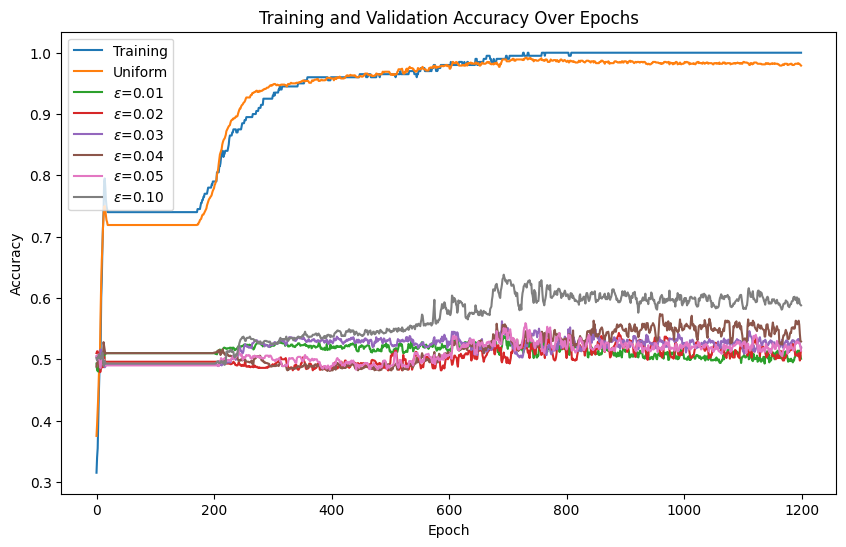

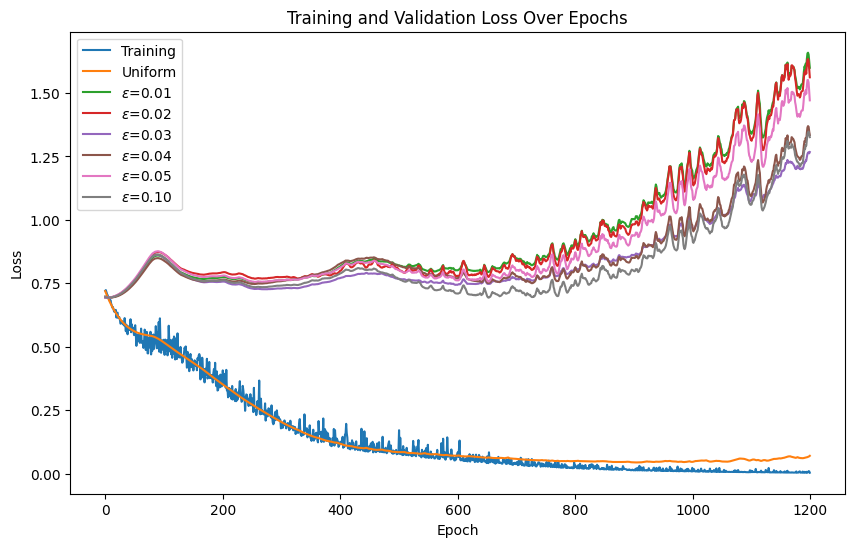

In [537]:
net_1 = Net()
train_model_bce(net_1, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1200, lr=0.00025)

Accuracy: 0.9729999899864197


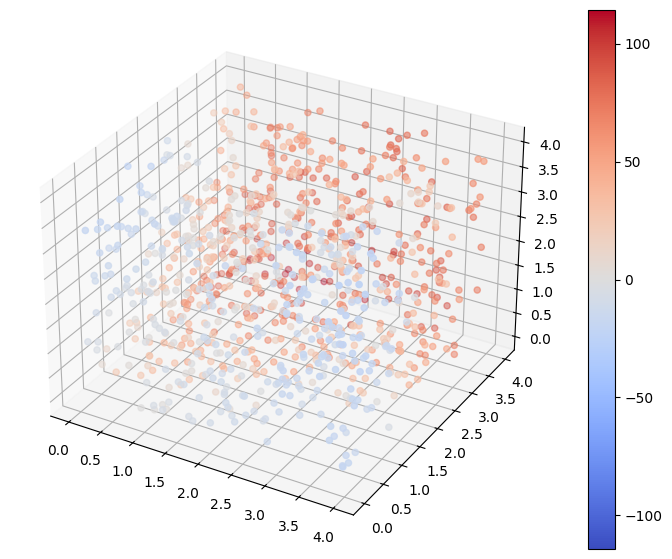

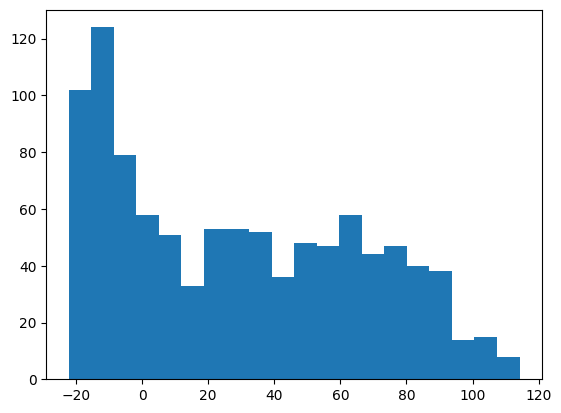

tensor(0.9730)

In [538]:
test_model(net_1, dataset_test_uniform)

Accuracy: 0.5080000162124634


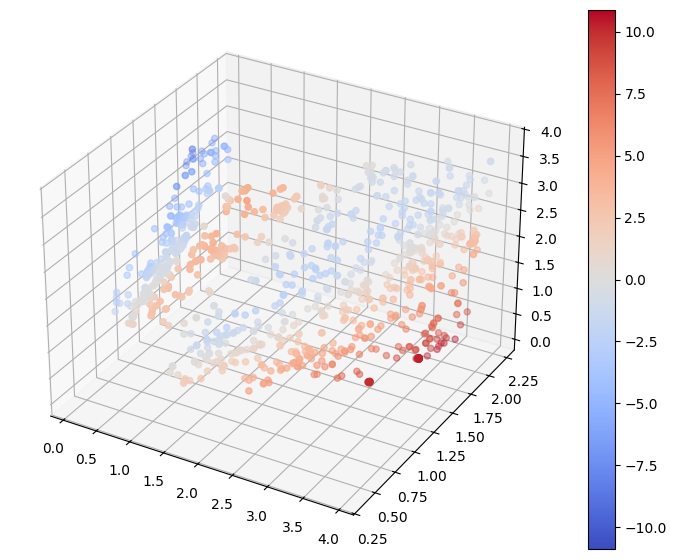

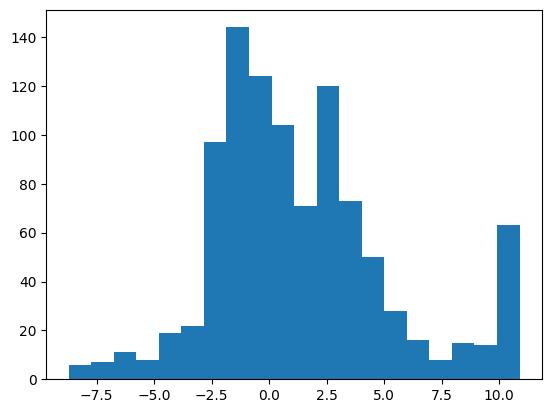

tensor(0.5080)

In [539]:
test_model(net_1, dataset_test_near_001)

Accuracy: 0.5059999823570251


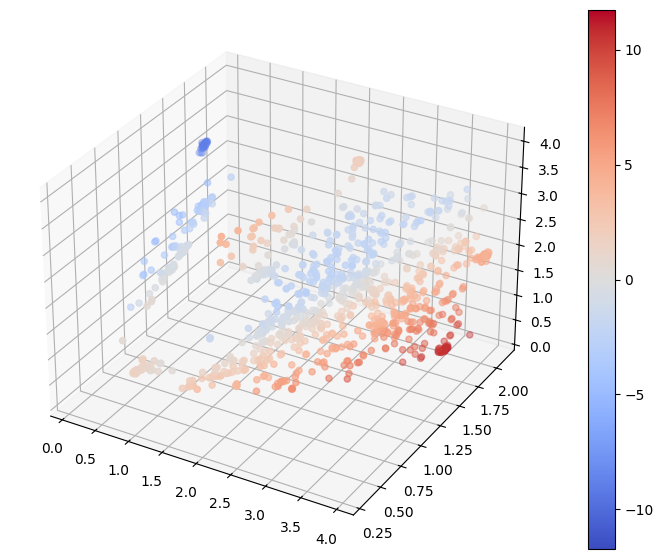

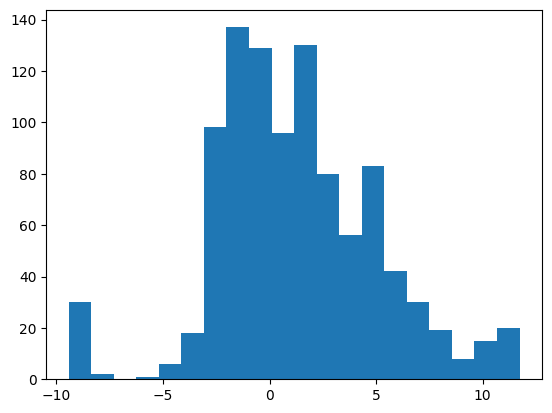

tensor(0.5060)

In [540]:
test_model(net_1, dataset_test_near_002)

Accuracy: 0.5559999942779541


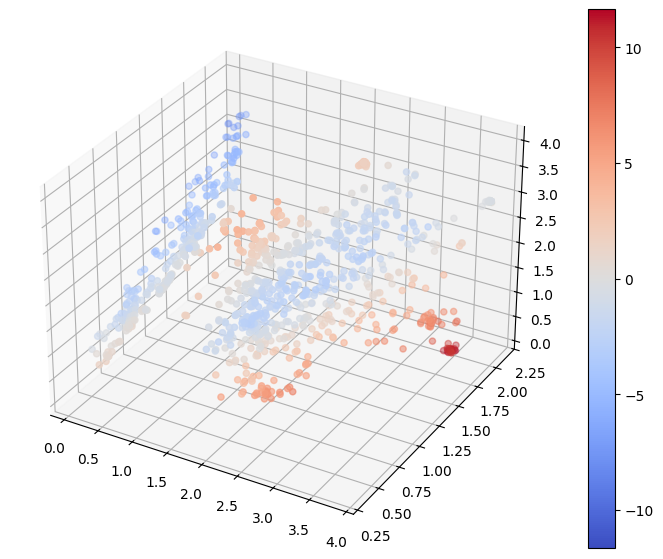

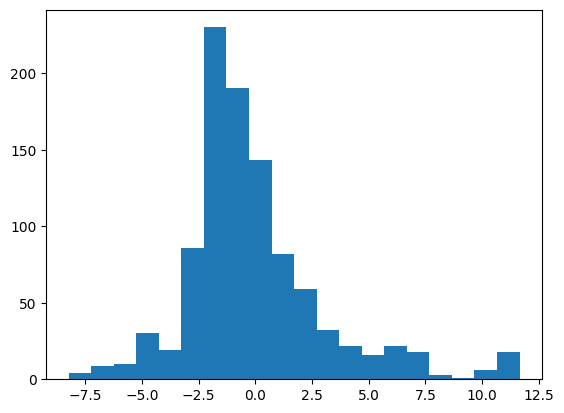

tensor(0.5560)

In [541]:
test_model(net_1, dataset_test_near_003)

Accuracy: 0.5450000166893005


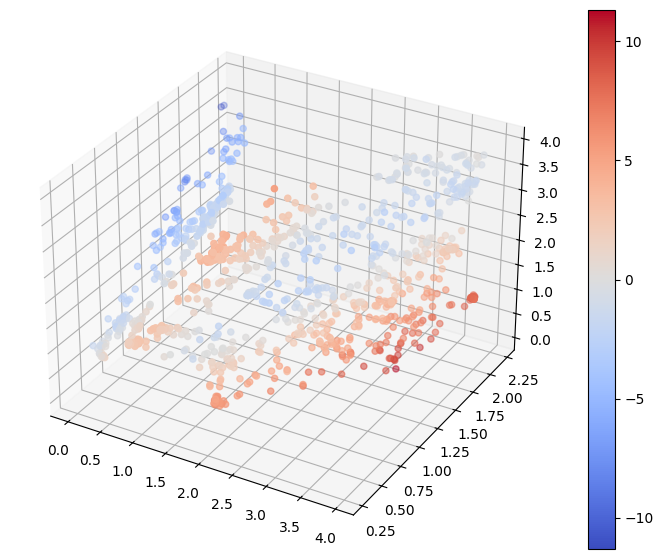

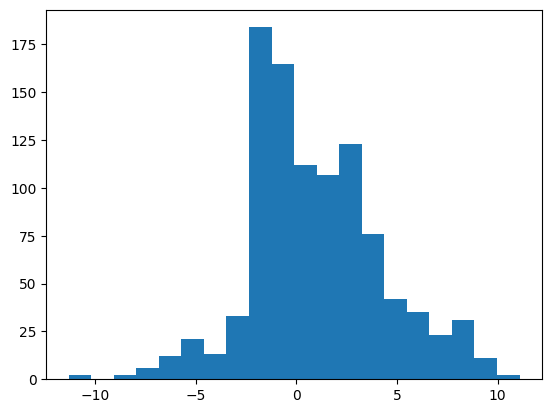

tensor(0.5450)

In [542]:
test_model(net_1, dataset_test_near_004)

Accuracy: 0.550000011920929


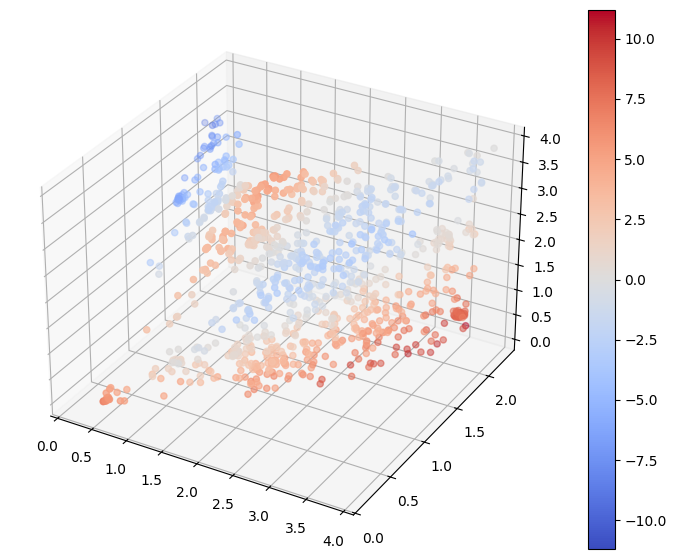

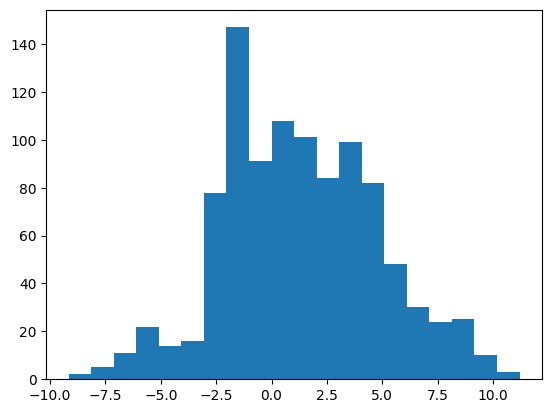

tensor(0.5500)

In [543]:
test_model(net_1, dataset_test_near_005)

Accuracy: 0.5870000123977661


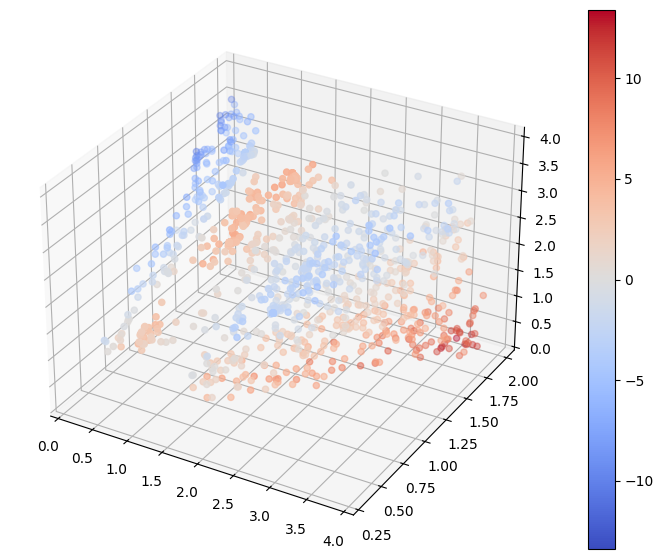

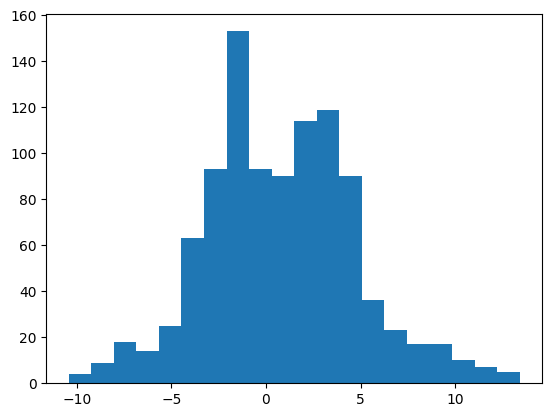

tensor(0.5870)

In [544]:
test_model(net_1, dataset_test_near_010)

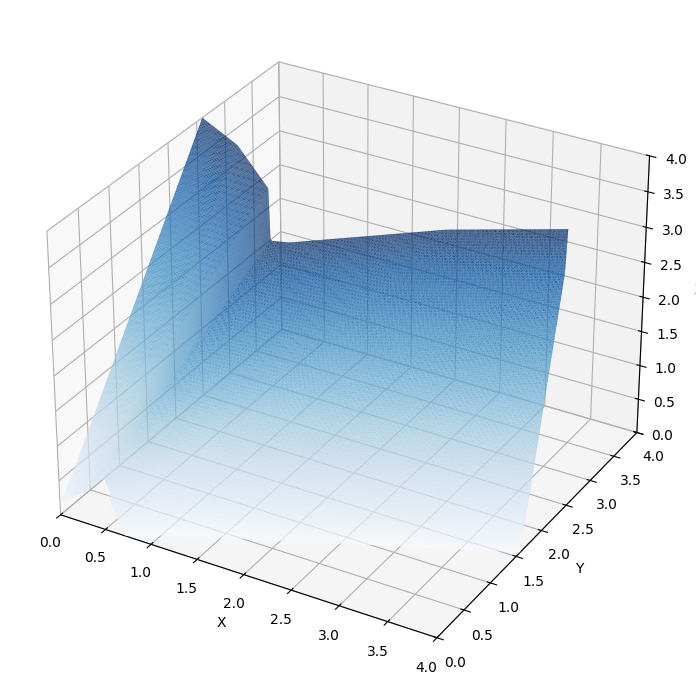

In [545]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from skimage.measure import marching_cubes
from matplotlib.tri import Triangulation

def plot_contour(net, domain=(0, 4), resolution=200):
    # Create a 3D grid of points
    x = np.linspace(domain[0], domain[1], resolution)
    y = np.linspace(domain[0], domain[1], resolution)
    z = np.linspace(domain[0], domain[1], resolution)
    xx, yy, zz = np.meshgrid(x, y, z, indexing='ij')
    grid_points = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
    grid_points_tensor = torch.tensor(grid_points, dtype=torch.float32)

    # Make predictions
    net.eval()
    with torch.no_grad():
        predictions = net(grid_points_tensor).cpu().numpy()

    # Reshape predictions to match the grid shape
    predictions = predictions.reshape(xx.shape)

    # Calculate spacing between grid points
    dx = x[1] - x[0]
    dy = y[1] - y[0]
    dz = z[1] - z[0]
    spacing = (dx, dy, dz)

    # Extract the 0-level isosurface with correct spacing and origin
    verts, faces, normals, values = marching_cubes(
        predictions,
        level=0,
        spacing=spacing,
        allow_degenerate=False
    )

    # Adjust vertices according to the domain
    origin = (x[0], y[0], z[0])
    verts += np.array(origin)

    # Plot the 3D decision boundary
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(
        verts[:, 0], verts[:, 1], faces, verts[:, 2],
        cmap='Blues', lw=1, edgecolor='none', alpha=0.9
    )
    ax.set_xlim(domain)
    ax.set_ylim(domain)
    ax.set_zlim(domain)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.tight_layout()
    plt.show()

    
plot_contour(net_1)

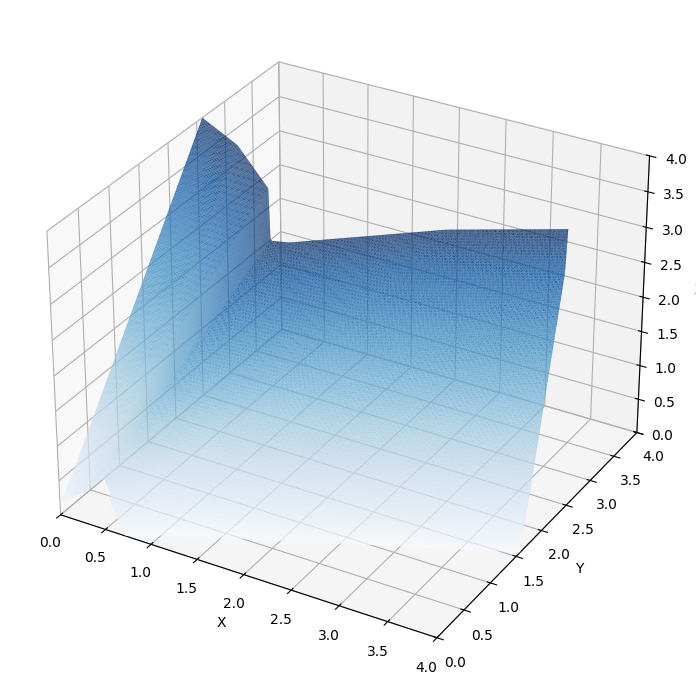

In [546]:
plot_contour(net_1)

In [219]:
class HingeLoss(nn.Module):
    def __init__(self):
        super(HingeLoss, self).__init__()
    
    def forward(self, y_pred, y_true):
        loss = nn.functional.relu(0.5-y_true * y_pred)
        mean_loss = torch.mean(loss)
        return mean_loss
    
class QuadraticHingeLoss(nn.Module):
    def __init__(self):
        super(QuadraticHingeLoss, self).__init__()

    def forward(self, y_pred, y_true):
        loss = nn.functional.relu(0.5-y_true * y_pred) ** 2
        mean_loss = torch.mean(loss)
        return mean_loss

In [519]:
def train_model_hinge(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                      dataset_validation003, dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = HingeLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)

    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss = criterion(outputs, labels)
            avg_loss_train += loss.item()
            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                       'Validation1 Accuracy': validation1_accuracy,
                                        'Validation001 Accuracy': validation001_accuracy, 
                                        'Validation002 Accuracy': validation002_accuracy, 
                                        'Validation003 Accuracy': validation003_accuracy, 
                                        'Validation004 Accuracy': validation004_accuracy, 
                                        'Validation005 Accuracy': validation005_accuracy, 
                                        'Validation010 Accuracy': validation010_accuracy})
        
        # Plot the decision boundary after each 20% of the epochs
        if (epoch + 1) % (epochs // 5) == 0:
            plot_contour(net)
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    
    #test_model(net, dataset_train)
    #test_model(net, dataset_validation1)
    #test_model(net, dataset_validation001)
    #test_model(net, dataset_validation002)
    #test_model(net, dataset_validation003)
    #test_model(net, dataset_validation004)
    #test_model(net, dataset_validation005)
    #test_model(net, dataset_validation010)

Overall Training Progress:  20%|██        | 200/1000 [01:01<03:53,  3.42it/s, Training Accuracy=0.96, Validation1 Accuracy=0.972, Validation001 Accuracy=0.553, Validation002 Accuracy=0.641, Validation003 Accuracy=0.611, Validation004 Accuracy=0.592, Validation005 Accuracy=0.651, Validation010 Accuracy=0.729] 

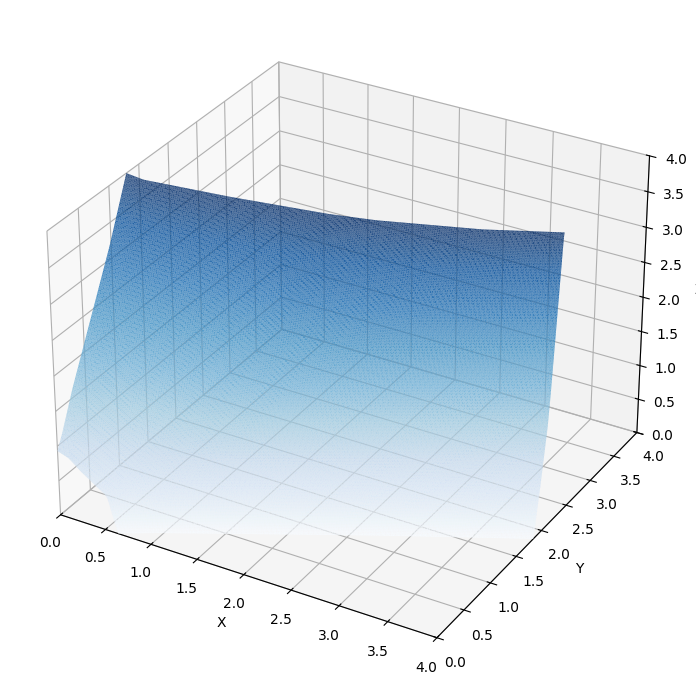

Overall Training Progress:  40%|████      | 400/1000 [02:04<02:56,  3.40it/s, Training Accuracy=0.985, Validation1 Accuracy=0.986, Validation001 Accuracy=0.54, Validation002 Accuracy=0.538, Validation003 Accuracy=0.58, Validation004 Accuracy=0.575, Validation005 Accuracy=0.586, Validation010 Accuracy=0.666]  

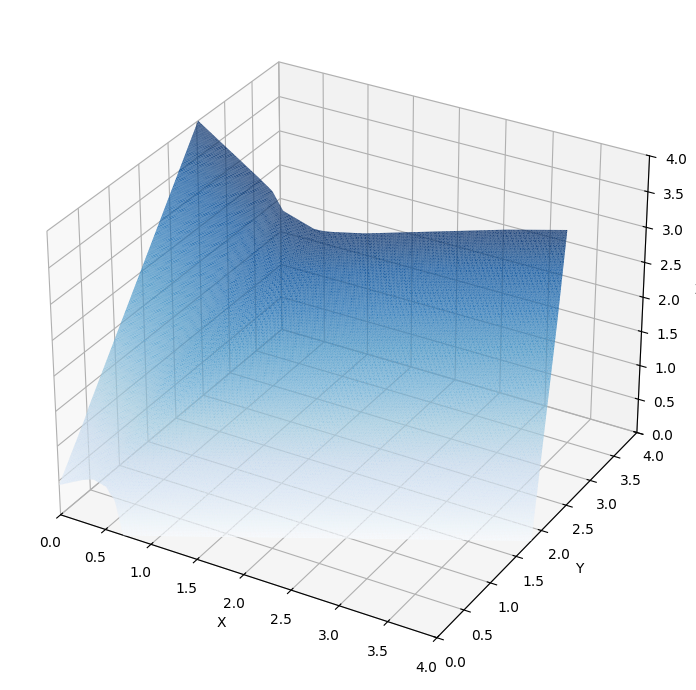

Overall Training Progress:  60%|██████    | 600/1000 [03:07<01:56,  3.42it/s, Training Accuracy=1, Validation1 Accuracy=0.989, Validation001 Accuracy=0.51, Validation002 Accuracy=0.588, Validation003 Accuracy=0.533, Validation004 Accuracy=0.59, Validation005 Accuracy=0.611, Validation010 Accuracy=0.666]      

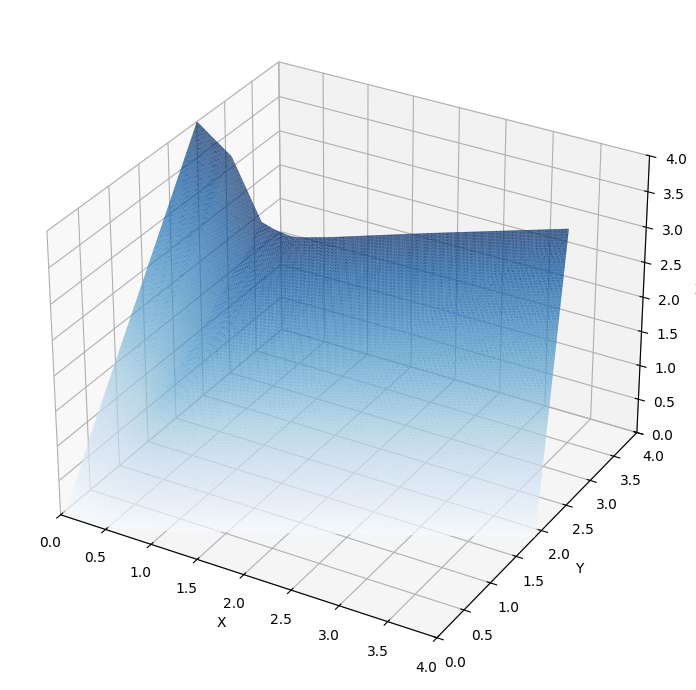

Overall Training Progress:  80%|████████  | 800/1000 [04:10<01:04,  3.11it/s, Training Accuracy=1, Validation1 Accuracy=0.986, Validation001 Accuracy=0.515, Validation002 Accuracy=0.507, Validation003 Accuracy=0.547, Validation004 Accuracy=0.552, Validation005 Accuracy=0.56, Validation010 Accuracy=0.62]      

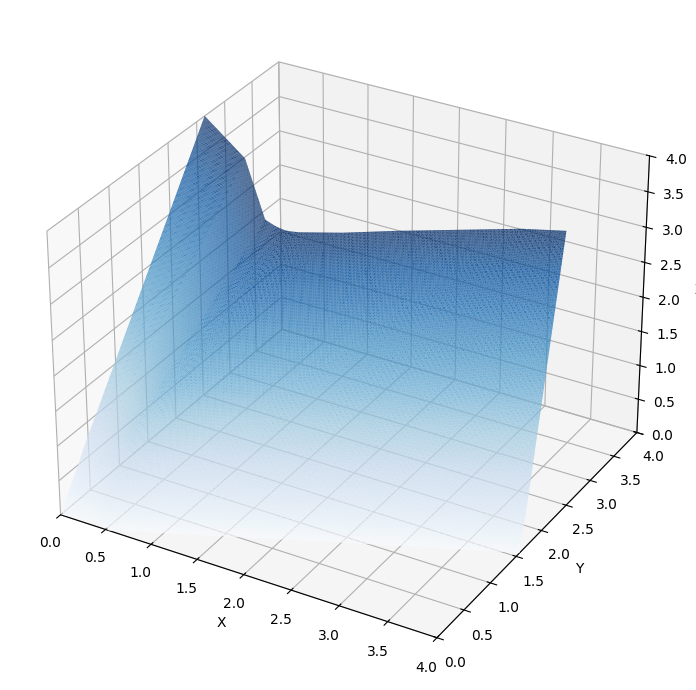

Overall Training Progress: 100%|██████████| 1000/1000 [05:14<00:00,  3.39it/s, Training Accuracy=1, Validation1 Accuracy=0.982, Validation001 Accuracy=0.524, Validation002 Accuracy=0.532, Validation003 Accuracy=0.532, Validation004 Accuracy=0.551, Validation005 Accuracy=0.571, Validation010 Accuracy=0.633]

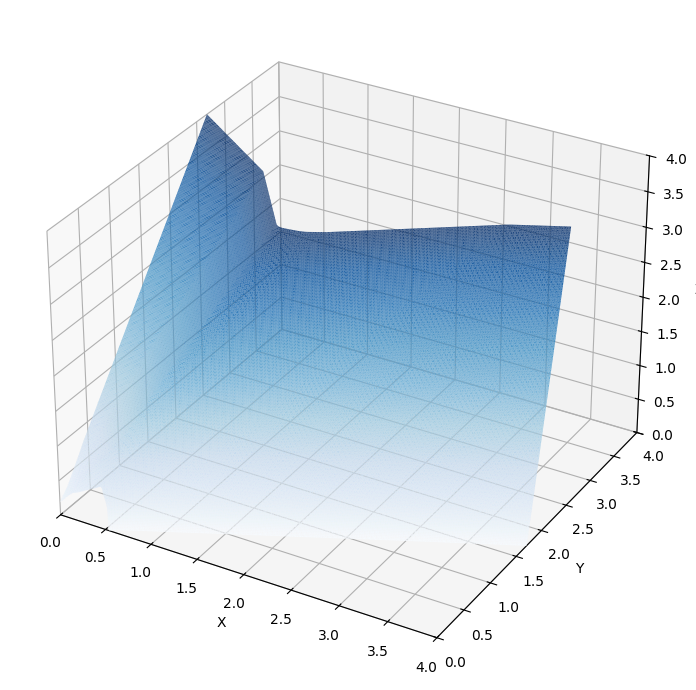

Overall Training Progress: 100%|██████████| 1000/1000 [05:17<00:00,  3.15it/s, Training Accuracy=1, Validation1 Accuracy=0.982, Validation001 Accuracy=0.524, Validation002 Accuracy=0.532, Validation003 Accuracy=0.532, Validation004 Accuracy=0.551, Validation005 Accuracy=0.571, Validation010 Accuracy=0.633]


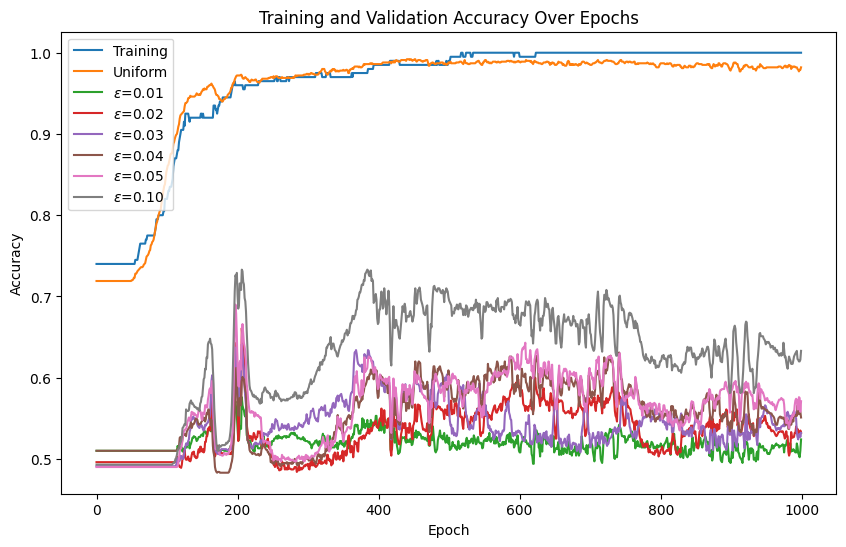

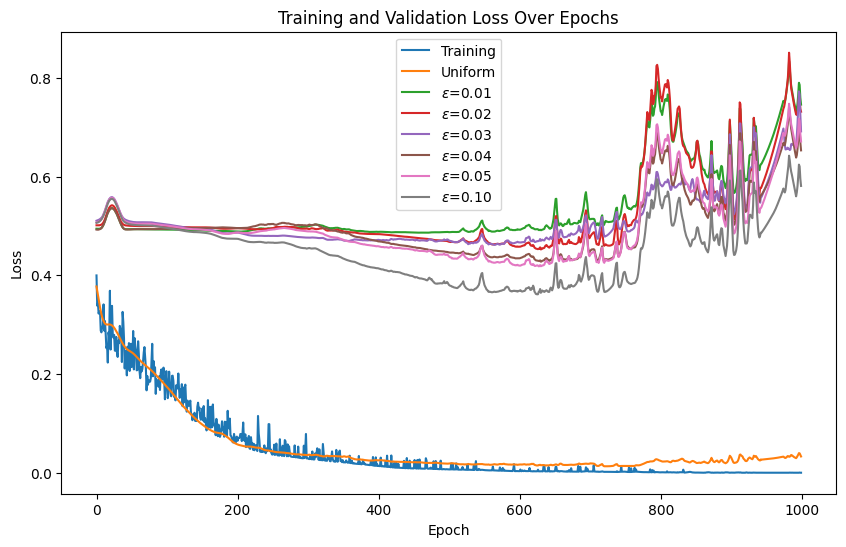

In [520]:
net_hinge = Net()
train_model_hinge(net_hinge, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0002)

Accuracy: 0.9829999804496765


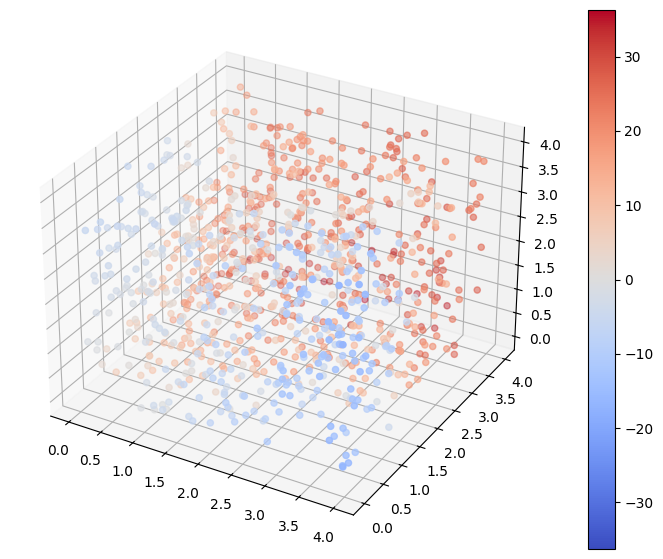

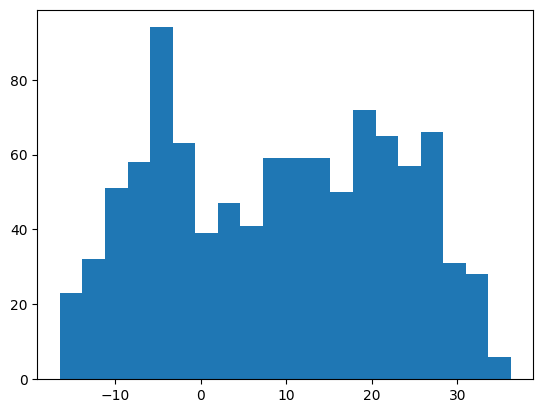

tensor(0.9830)

In [521]:
test_model(net_hinge, dataset_test_uniform)

Accuracy: 0.5189999938011169


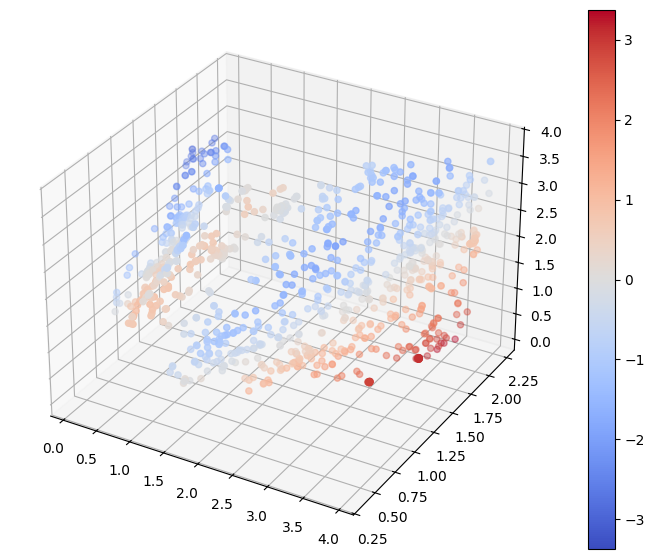

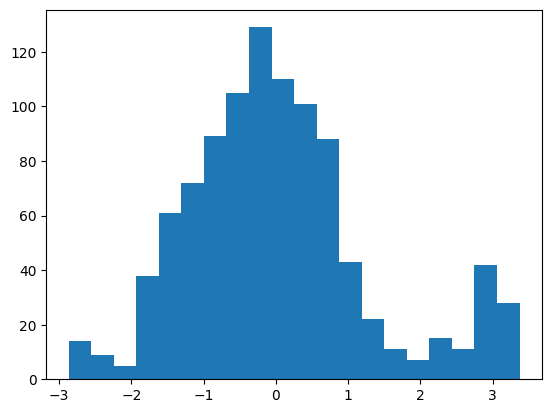

tensor(0.5190)

In [522]:
test_model(net_hinge, dataset_test_near_001)

Accuracy: 0.5199999809265137


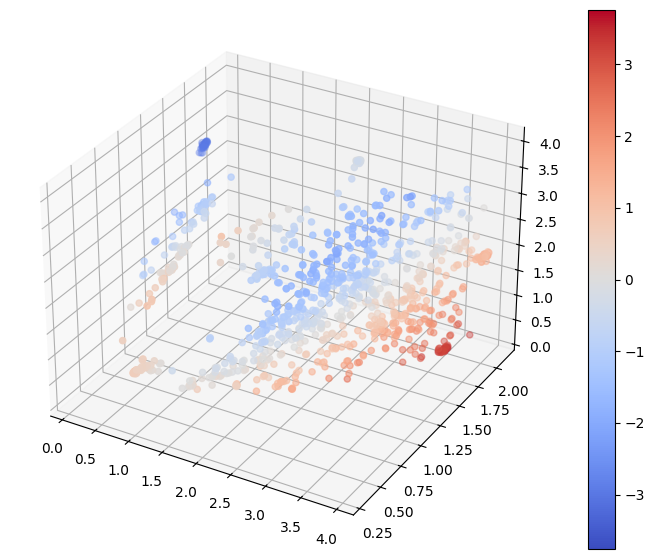

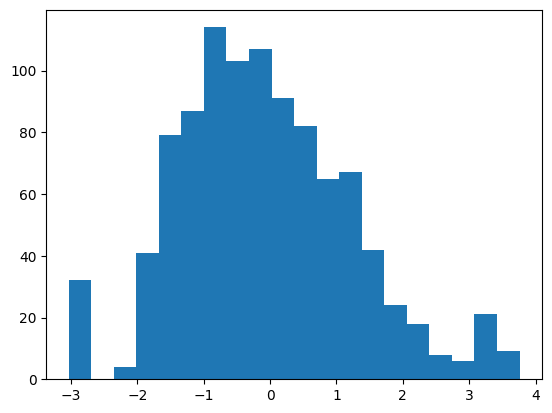

tensor(0.5200)

In [523]:
test_model(net_hinge, dataset_test_near_002)

Accuracy: 0.5479999780654907


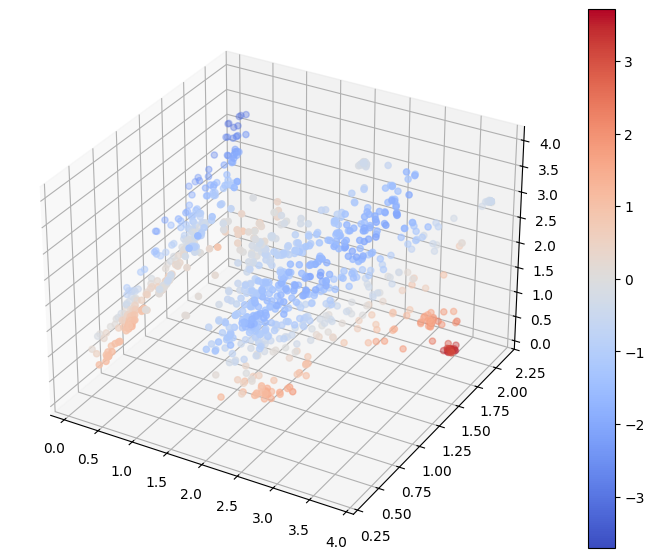

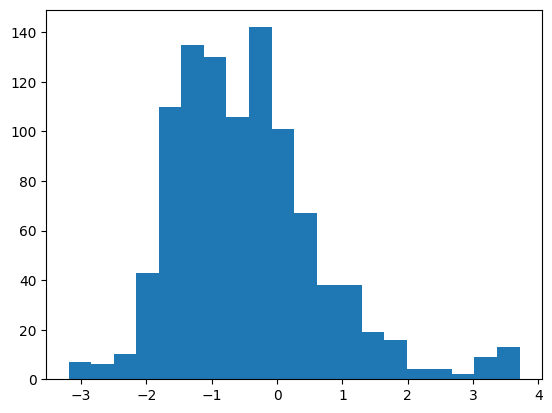

tensor(0.5480)

In [524]:
test_model(net_hinge, dataset_test_near_003)

Accuracy: 0.5509999990463257


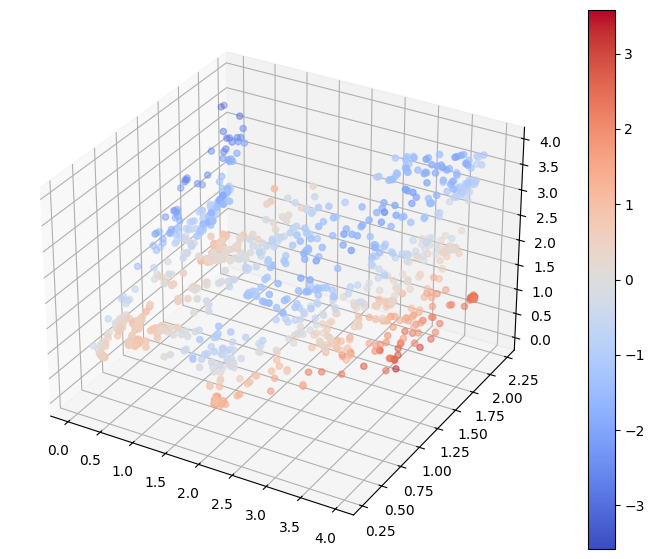

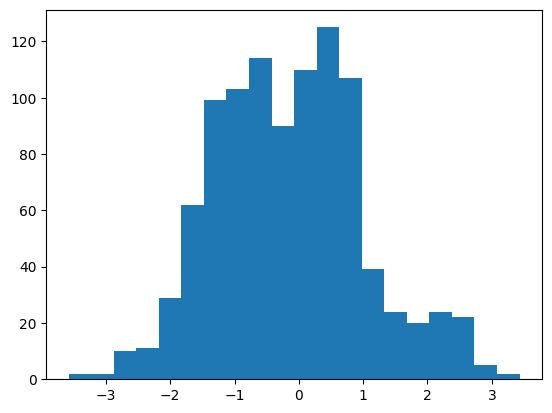

tensor(0.5510)

In [525]:
test_model(net_hinge, dataset_test_near_004)

Accuracy: 0.5720000267028809


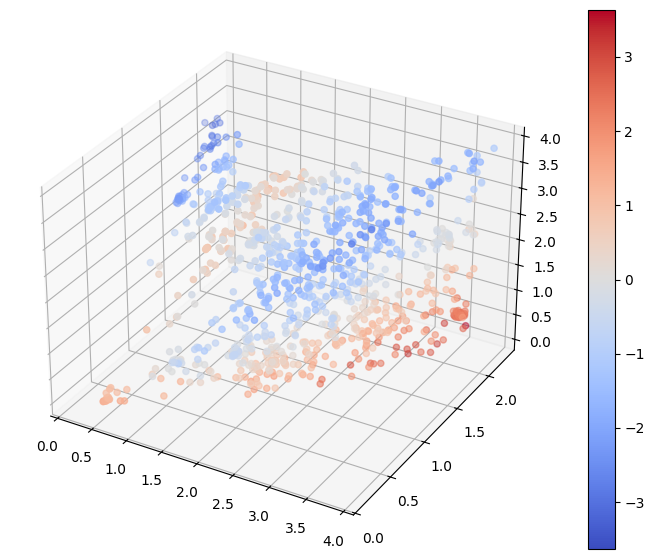

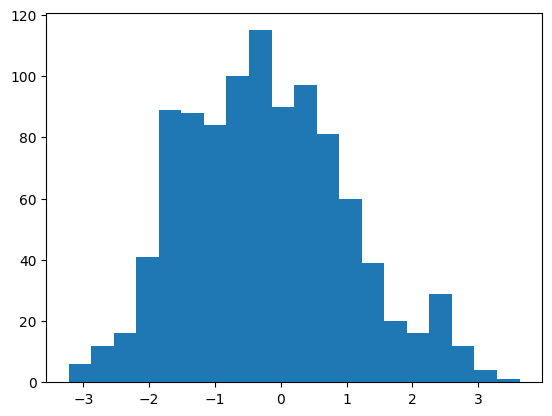

tensor(0.5720)

In [526]:
test_model(net_hinge, dataset_test_near_005)

Accuracy: 0.6269999742507935


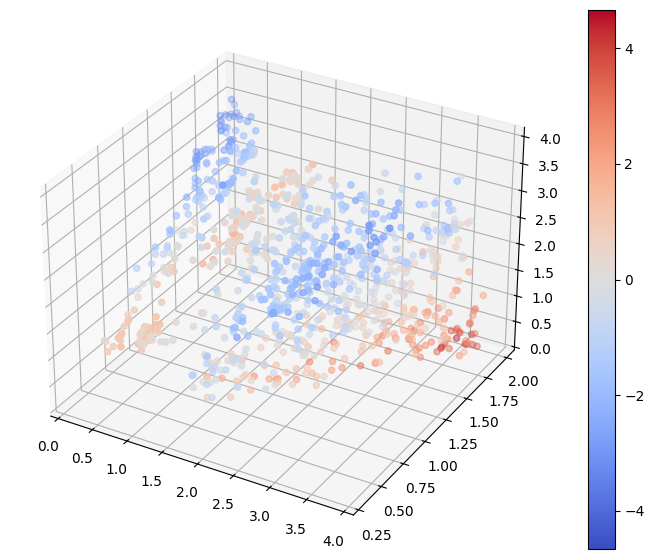

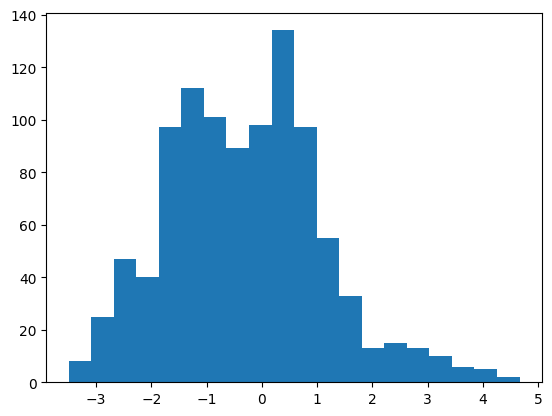

tensor(0.6270)

In [527]:
test_model(net_hinge, dataset_test_near_010)

In [528]:
def train_model_hinge_square(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                      dataset_validation003, dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = QuadraticHingeLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)

    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss = criterion(outputs, labels)
            avg_loss_train += loss.item()
            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                       'Validation1 Accuracy': validation1_accuracy,
                                        'Validation001 Accuracy': validation001_accuracy, 
                                        'Validation002 Accuracy': validation002_accuracy, 
                                        'Validation003 Accuracy': validation003_accuracy, 
                                        'Validation004 Accuracy': validation004_accuracy, 
                                        'Validation005 Accuracy': validation005_accuracy, 
                                        'Validation010 Accuracy': validation010_accuracy})
        
        # Plot the decision boundary after each 20% of the epochs
        if (epoch + 1) % (epochs // 5) == 0:
            plot_contour(net)
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    
    #test_model(net, dataset_train)
    #test_model(net, dataset_validation1)
    #test_model(net, dataset_validation001)
    #test_model(net, dataset_validation002)
    #test_model(net, dataset_validation003)
    #test_model(net, dataset_validation004)
    #test_model(net, dataset_validation005)
    #test_model(net, dataset_validation010)

Overall Training Progress:  20%|██        | 200/1000 [01:00<03:54,  3.41it/s, Training Accuracy=0.96, Validation1 Accuracy=0.959, Validation001 Accuracy=0.522, Validation002 Accuracy=0.482, Validation003 Accuracy=0.531, Validation004 Accuracy=0.486, Validation005 Accuracy=0.494, Validation010 Accuracy=0.543] 

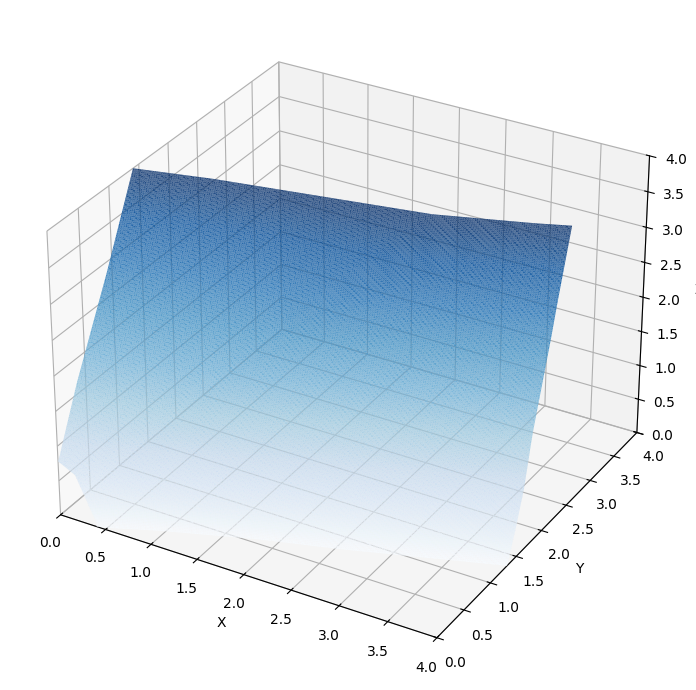

Overall Training Progress:  40%|████      | 400/1000 [02:03<02:56,  3.39it/s, Training Accuracy=0.985, Validation1 Accuracy=0.98, Validation001 Accuracy=0.546, Validation002 Accuracy=0.534, Validation003 Accuracy=0.554, Validation004 Accuracy=0.568, Validation005 Accuracy=0.597, Validation010 Accuracy=0.709] 

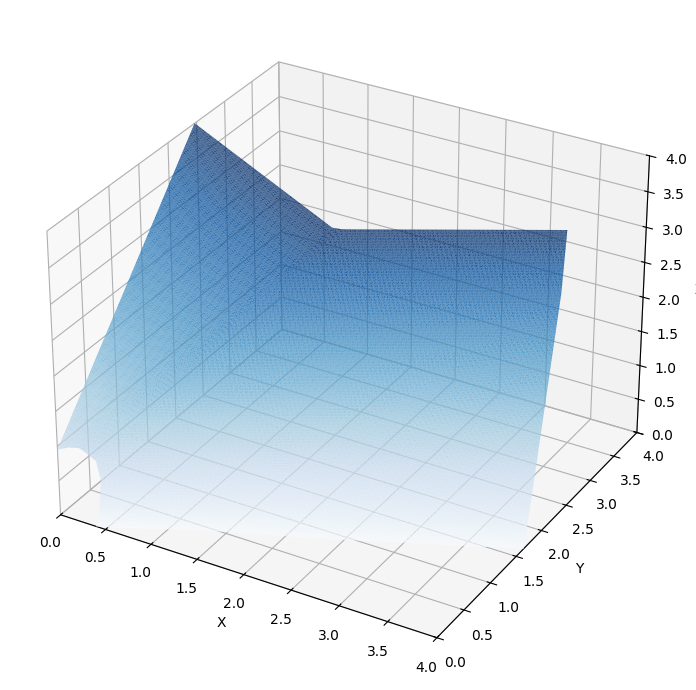

Overall Training Progress:  60%|██████    | 600/1000 [03:06<01:57,  3.41it/s, Training Accuracy=0.995, Validation1 Accuracy=0.988, Validation001 Accuracy=0.513, Validation002 Accuracy=0.537, Validation003 Accuracy=0.535, Validation004 Accuracy=0.55, Validation005 Accuracy=0.545, Validation010 Accuracy=0.633] 

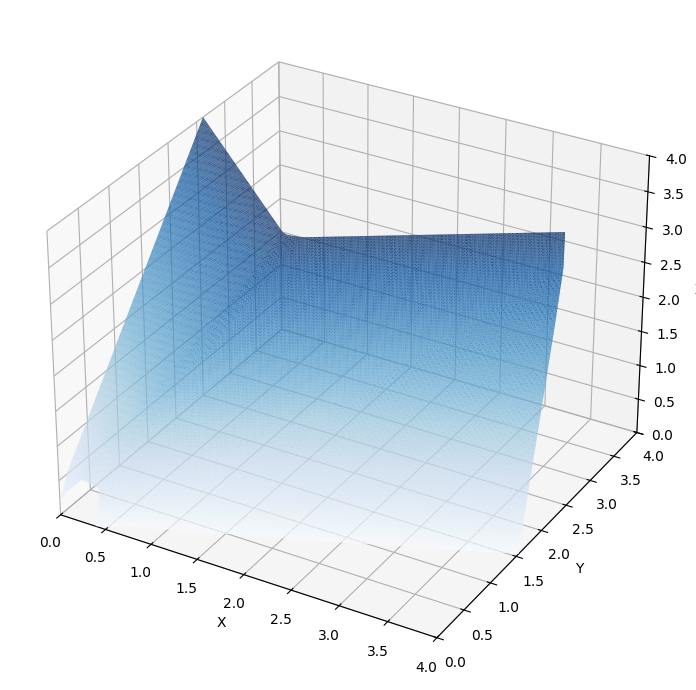

Overall Training Progress:  80%|████████  | 800/1000 [04:09<00:58,  3.42it/s, Training Accuracy=1, Validation1 Accuracy=0.987, Validation001 Accuracy=0.51, Validation002 Accuracy=0.529, Validation003 Accuracy=0.529, Validation004 Accuracy=0.559, Validation005 Accuracy=0.559, Validation010 Accuracy=0.619]     

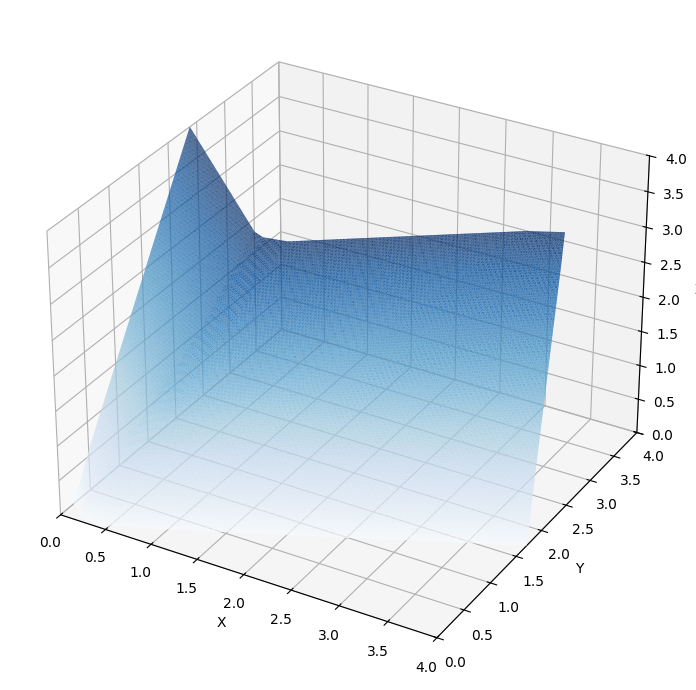

Overall Training Progress: 100%|██████████| 1000/1000 [05:12<00:00,  3.38it/s, Training Accuracy=1, Validation1 Accuracy=0.984, Validation001 Accuracy=0.51, Validation002 Accuracy=0.542, Validation003 Accuracy=0.503, Validation004 Accuracy=0.57, Validation005 Accuracy=0.563, Validation010 Accuracy=0.623]     

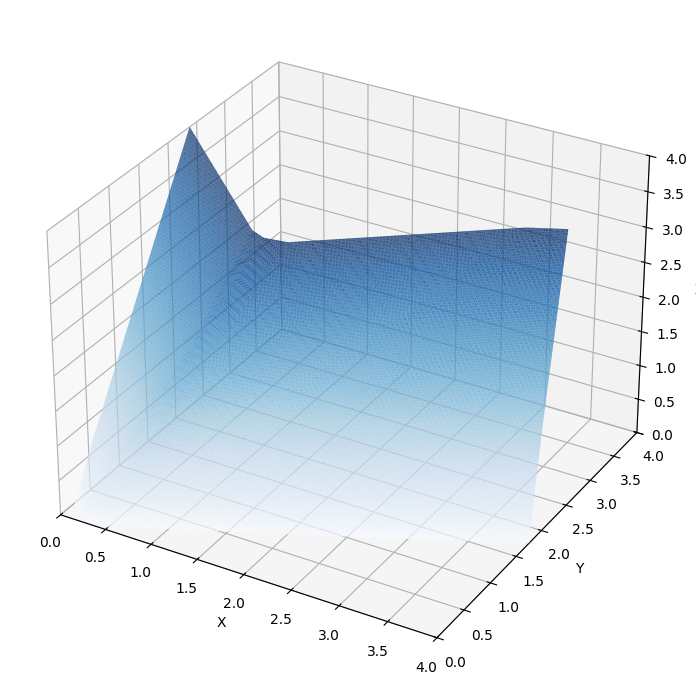

Overall Training Progress: 100%|██████████| 1000/1000 [05:16<00:00,  3.16it/s, Training Accuracy=1, Validation1 Accuracy=0.984, Validation001 Accuracy=0.51, Validation002 Accuracy=0.542, Validation003 Accuracy=0.503, Validation004 Accuracy=0.57, Validation005 Accuracy=0.563, Validation010 Accuracy=0.623]


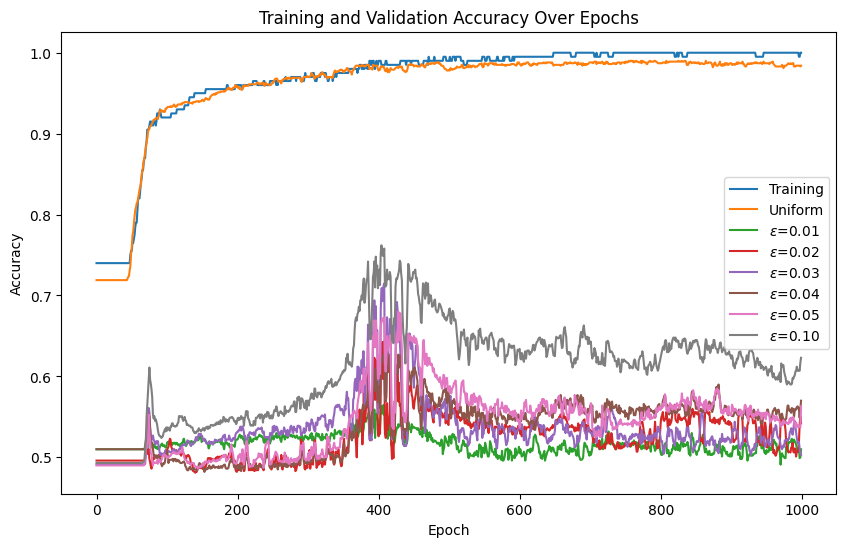

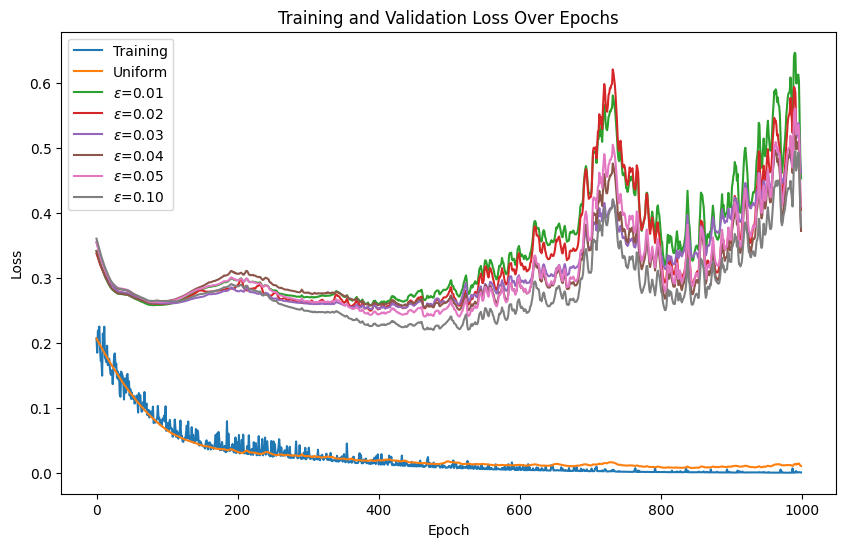

In [529]:
net_hinge_square = Net()
train_model_hinge_square(net_hinge_square, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0002)

Accuracy: 0.9750000238418579


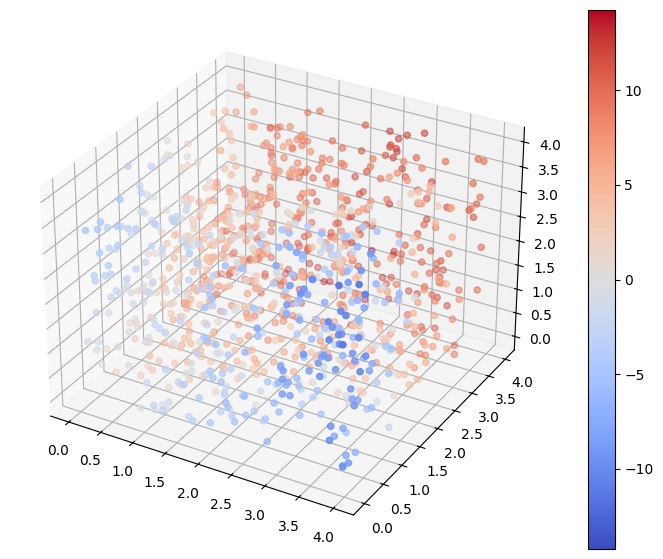

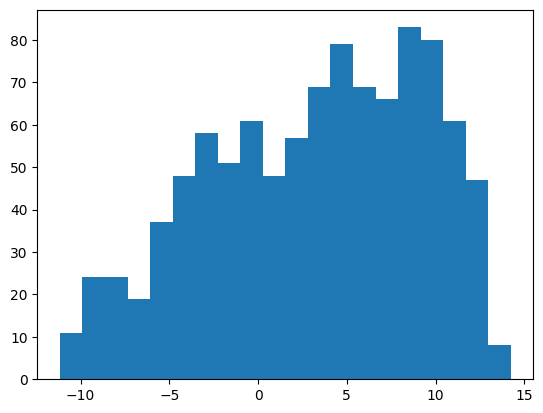

tensor(0.9750)

In [530]:
test_model(net_hinge_square, dataset_test_uniform)

Accuracy: 0.531000018119812


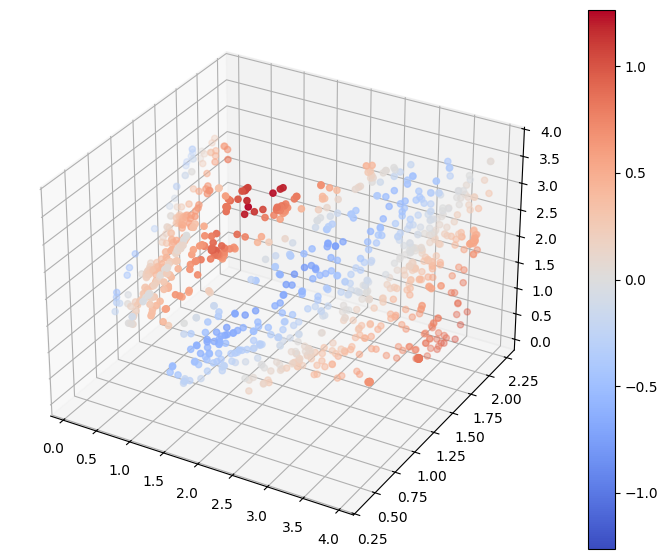

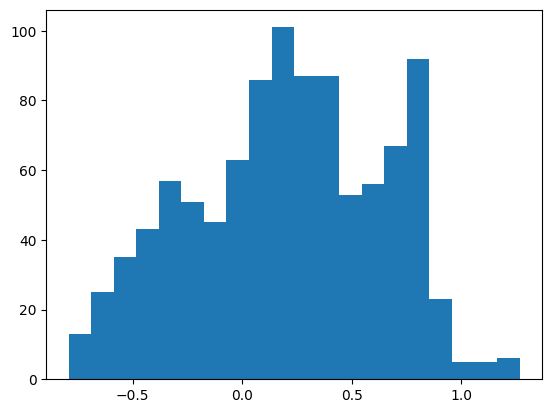

tensor(0.5310)

In [531]:
test_model(net_hinge_square, dataset_test_near_001)

Accuracy: 0.5090000033378601


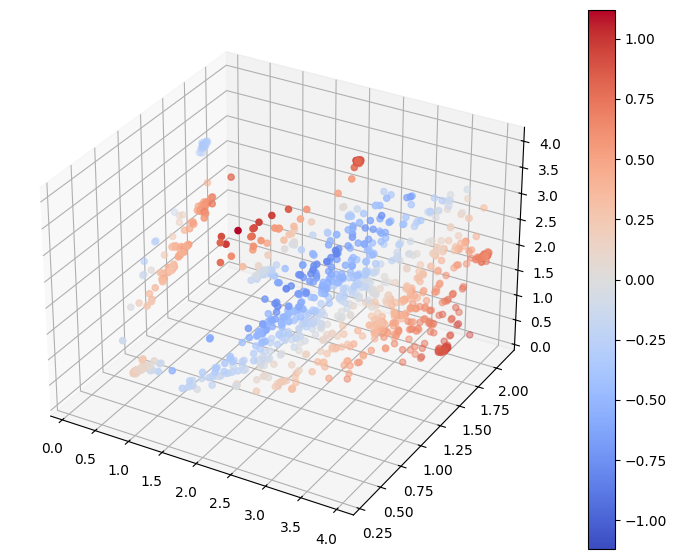

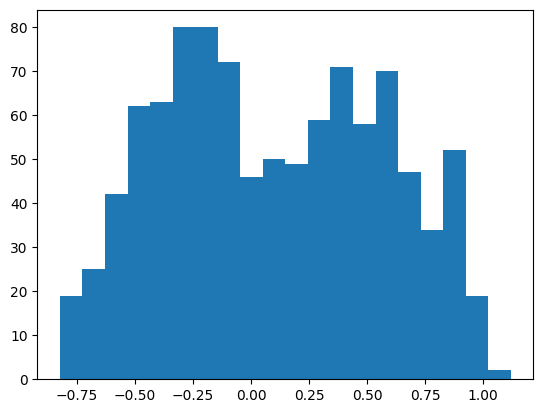

tensor(0.5090)

In [532]:
test_model(net_hinge_square, dataset_test_near_002)

Accuracy: 0.5490000247955322


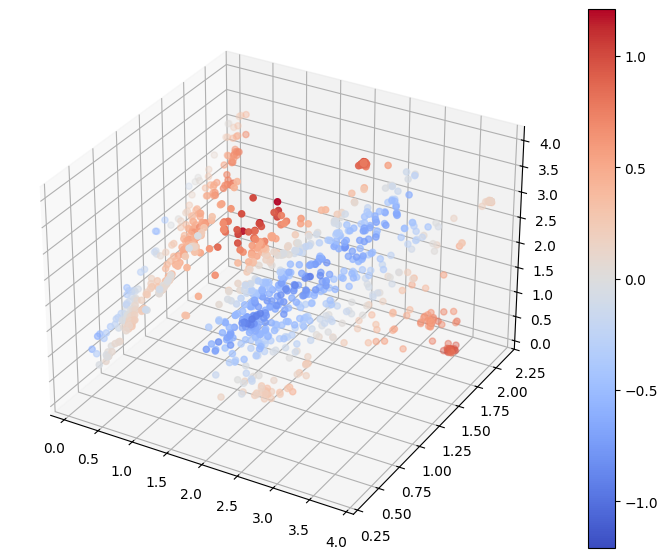

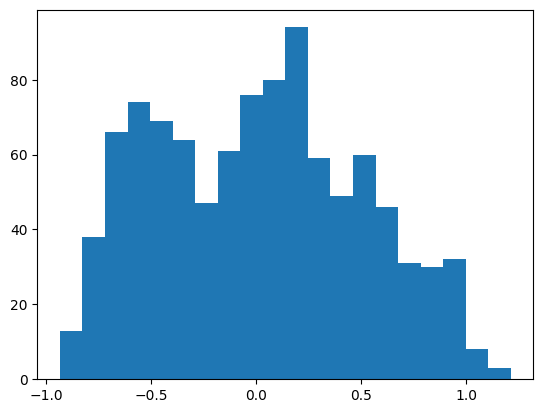

tensor(0.5490)

In [533]:
test_model(net_hinge_square, dataset_test_near_003)

Accuracy: 0.5699999928474426


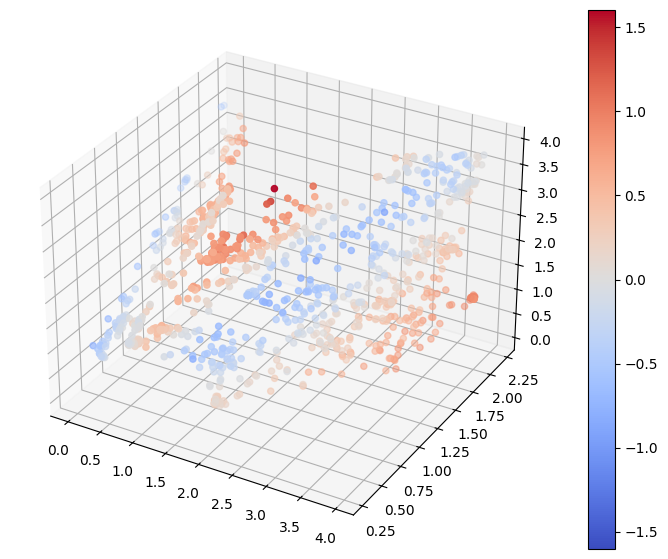

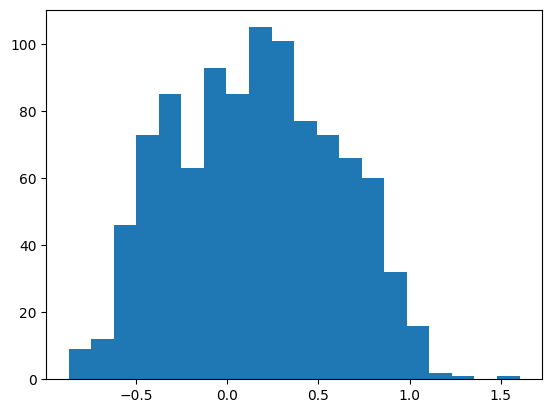

tensor(0.5700)

In [534]:
test_model(net_hinge_square, dataset_test_near_004)

Accuracy: 0.5879999995231628


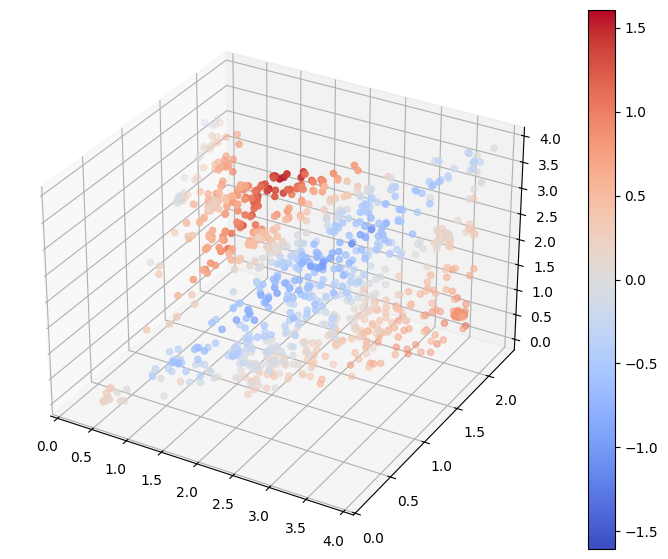

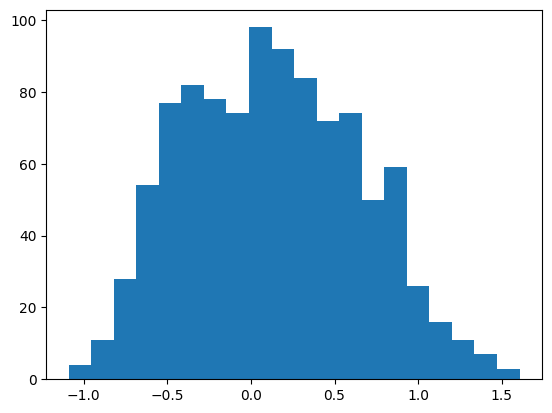

tensor(0.5880)

In [535]:
test_model(net_hinge_square, dataset_test_near_005)

Accuracy: 0.6269999742507935


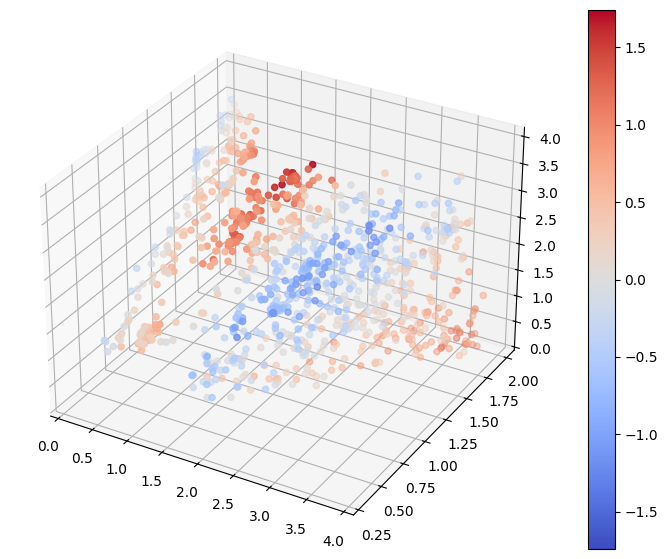

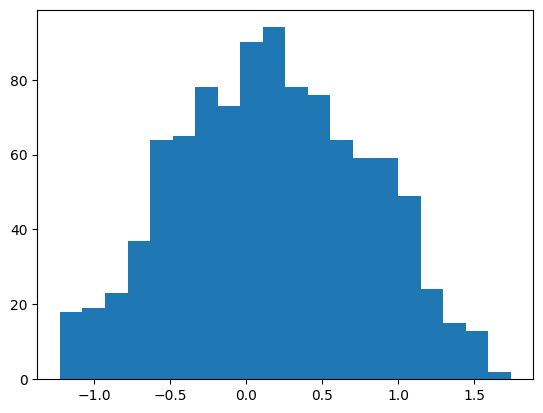

tensor(0.6270)

In [536]:
test_model(net_hinge_square, dataset_test_near_010)

In [278]:
def dynamical_system_vector(point):
    x,y,z = point[0], point[1], point[2]
    xp = (1-x/3)*x - 5*x*y - 4*x*z
    yp = 2*(1-y/2)*y - 3*x*y - 7*y*z
    zp = 2*(1-z)*z - 7*x*z - 10*y*z
    return torch.tensor([xp, yp, zp], dtype=torch.float32)

def custom_loss_function(model, batch_inputs, var=1e-4):
    batch_loss = 0.0
    def dirac(value, var=var):
        return torch.exp(-(value)**2 / (2 * var**2)) / torch.sqrt(torch.tensor(2 * torch.pi * var**2))
    
    for input_point in batch_inputs:
        input_point = input_point.clone().detach().requires_grad_(True)
        prediction = model(input_point.unsqueeze(0))
        grad_output = torch.ones_like(prediction)
        gradient = torch.autograd.grad(prediction, input_point, grad_outputs=grad_output, create_graph=True)[0]
        dynamical_vector = dynamical_system_vector(input_point)

        #gradient_normalized = gradient / (torch.norm(gradient) + 1e-8)
        #dynamical_vector_normalized = dynamical_vector / (torch.norm(dynamical_vector) + 1e-8)

        # Check if the norm of the gradient or dynamical vector is zero
        gradient_norm = torch.norm(gradient)
        dynamical_vector_norm = torch.norm(dynamical_vector)
        
        if gradient_norm == 0 or dynamical_vector_norm == 0:
            gradient_normalized = torch.zeros_like(gradient)
            dynamical_vector_normalized = torch.zeros_like(dynamical_vector)
        else:
            gradient_normalized = gradient / gradient_norm
            dynamical_vector_normalized = dynamical_vector / dynamical_vector_norm


        inner_product = torch.dot(gradient_normalized, dynamical_vector_normalized)
        dirac_value = dirac(prediction)
        gradient_norm = torch.norm(gradient)
        loss = (inner_product ** 2) * gradient_norm * dirac_value
        batch_loss += loss
    
    # Average the loss over the batch
    batch_loss /= len(batch_inputs)
    
    return batch_loss


In [78]:
'''from torch.autograd import Variable

def find_decision_boundary_batch(f, initial_points, lr=0.001, threshold=0.5, max_iter=1000):
    f.eval()
    x = Variable(initial_points.clone(), requires_grad=True)
    optimizer = torch.optim.Adam([x], lr=lr)
    converged = torch.zeros(initial_points.size(0), dtype=torch.bool)
    
    for i in range(max_iter):
        optimizer.zero_grad()
        output = f(x)
        loss = (output) ** 2
        loss = loss.mean(dim=1)  # Assuming f returns a tensor of shape (n_points,)
        loss.backward(torch.ones_like(loss))
        optimizer.step()
        
        # Check convergence for each point
        converged |= (loss < threshold)
        
        # Check if points are within the range
        within_bounds = (x[:, 0] >= 0) & (x[:, 0] <= 4) & (x[:, 1] >= 0) & (x[:, 1] <= 4) & (x[:, 2] >= 0) & (x[:, 2] <= 4)
        converged &= within_bounds  # Only consider points within bounds as converged
        
        if converged.all():
            print(f"All converged after {i+1} iterations.")
            break
    
    return x, converged


#def collect_converged_points(f, target_count=20):
    #collected_points = []
    #while len(collected_points) < target_count:
        #n_points_needed = 10000
        #initial_points = (torch.rand(n_points_needed, 2) * 4) - 2  # Generate more points
        #x_star_batch, converged = find_decision_boundary_batch(f, initial_points)
        #converged_points = x_star_batch[converged]
        
        # Generate random shifts
        #shifts = (torch.rand(converged_points.size()) * 0.02) - 0.01  # Shifts in the range [-0.01, 0.01]
        #converged_points_shifted = converged_points + shifts
        
        #collected_points.extend(converged_points_shifted.detach().numpy().tolist())  # Convert to list and append
        
    #return torch.tensor(collected_points[:target_count])  # Return the first 1,000 converged points

# Example usage
#collected_points = collect_converged_points(net_4)
#print(f"Collected {len(collected_points)} converged points.")
#outputs = net_4(collected_points)
# Assuming collected_points and outputs are already defined as shown above
#for point, output in zip(collected_points, outputs):
    #print(f"Point: {point}, Output: {output.item()}")

def collect_converged_points_without_noise(f, target_count=20):
    collected_points = []
    while len(collected_points) < target_count:
        n_points_needed = 10000
        initial_points = (torch.rand(n_points_needed, 3) * 4)
        x_star_batch, converged = find_decision_boundary_batch(f, initial_points)
        converged_points = x_star_batch[converged]
        collected_points.extend(converged_points.detach().numpy().tolist())  # Convert to list and append
        
    return torch.tensor(collected_points[:target_count])  

# Example usage
collected_points = collect_converged_points_without_noise(net_4, target_count=100)
print(f"Collected {len(collected_points)} converged points.")
outputs = net_4(collected_points)
# Assuming collected_points and outputs are already defined as shown above
for point, output in zip(collected_points, outputs):
    print(f"Point: {point}, Output: {output.item()}")'''

Collected 100 converged points.
Point: tensor([2.7817, 1.3401, 0.7374]), Output: -0.019580811262130737
Point: tensor([3.7242, 1.9723, 2.5976]), Output: 0.10945835709571838
Point: tensor([2.7424, 1.3563, 1.6872]), Output: 0.014490514993667603
Point: tensor([1.9783, 0.8739, 0.4774]), Output: -0.00014162063598632812
Point: tensor([2.9397, 1.6090, 3.3126]), Output: -0.10826769471168518
Point: tensor([0.6137, 1.2900, 2.7682]), Output: 2.440810203552246e-05
Point: tensor([3.5093, 1.7691, 0.9883]), Output: -1.7076730728149414e-05
Point: tensor([0.9429, 1.6006, 3.5243]), Output: -0.0068153440952301025
Point: tensor([2.1815, 1.0625, 2.0308]), Output: -0.0061227381229400635
Point: tensor([0.6221, 1.8952, 3.6263]), Output: 0.0003992915153503418
Point: tensor([0.4578, 2.1270, 3.7408]), Output: 0.11855632066726685
Point: tensor([1.0228, 1.5938, 3.5886]), Output: 1.5497207641601562e-06
Point: tensor([3.2499, 1.6676, 2.2319]), Output: -1.519918441772461e-06
Point: tensor([2.6714, 1.2401, 0.4040]), Ou

In [339]:
## Find points on the decision boundary by bisection
def find_decision_boundary_points_bisection(f, target_count, threshold=1e-6):
    collected_points = []
    for i in range(target_count):
        a = torch.rand(3) * 4
        b = torch.rand(3) * 4
        while (f(a) * f(b) > 0):
            a = torch.rand(3) * 4 
            b = torch.rand(3) * 4
        while torch.norm(a - b) > threshold:
            c = (a + b) / 2
            if f(a) * f(c) < 0:
                b = c
            else:
                a = c
        collected_points.append(c)
    return torch.stack(collected_points)

# Example usage
collected_points = find_decision_boundary_points_bisection(net_hinge_square, target_count=5000)
print(f"Collected {len(collected_points)} converged points.")
outputs = net_hinge_square(collected_points)
# Assuming collected_points and outputs are already defined as shown above
for point, output in zip(collected_points, outputs):
    print(f"Point: {point}, Output: {output.item()}")
        

Collected 5000 converged points.
Point: tensor([2.3656, 1.2843, 3.1125]), Output: -4.678964614868164e-06
Point: tensor([0.5911, 1.4271, 3.1426]), Output: 1.1622905731201172e-06
Point: tensor([2.7753, 1.5604, 3.5095]), Output: -3.8743019104003906e-07
Point: tensor([1.5699, 0.7347, 1.9225]), Output: 1.4007091522216797e-06
Point: tensor([3.0055, 1.6925, 3.0071]), Output: -2.294778823852539e-06
Point: tensor([2.3295, 1.2350, 2.2938]), Output: 3.069639205932617e-06
Point: tensor([2.8968, 1.5497, 2.3057]), Output: -5.3942203521728516e-06
Point: tensor([1.8394, 0.7267, 0.6175]), Output: 1.1622905731201172e-06
Point: tensor([3.0423, 1.4994, 1.5042]), Output: -3.8743019104003906e-07
Point: tensor([0.0184, 1.6770, 2.6689]), Output: 1.8775463104248047e-06
Point: tensor([1.6670, 0.7907, 1.7220]), Output: -1.1026859283447266e-06
Point: tensor([0.9603, 1.3065, 3.5181]), Output: 1.6391277313232422e-06
Point: tensor([0.6431, 1.0028, 2.4894]), Output: -2.294778823852539e-06
Point: tensor([0.8416, 0.537

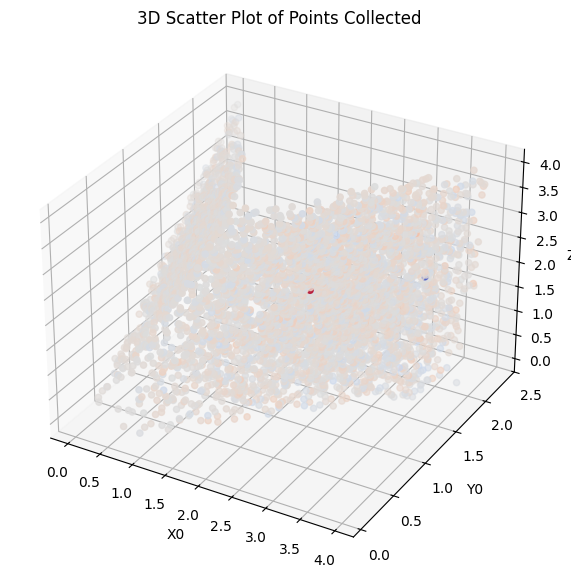

In [340]:
# Prepare the figure and 3D axis
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using x0, y0, z0 as coordinates
# Color by 'attracted': map the 'attracted' column to colors
scatter = ax.scatter(collected_points[:, 0], collected_points[:, 1], collected_points[:, 2], c=outputs.detach().numpy(), cmap='coolwarm')


# Labels
ax.set_xlabel('X0')
ax.set_ylabel('Y0')
ax.set_zlabel('Z0')
ax.set_title('3D Scatter Plot of Points Collected')

# Show plot
plt.show()

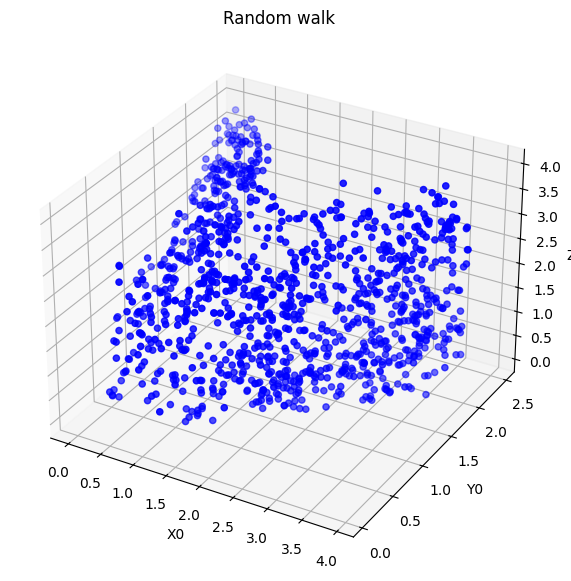

In [80]:
def remove_component_along_direction(a, b):
    projection = (torch.dot(a, b) / torch.dot(b, b)) * b
    return a - projection

def compute_input_gradient(net, input_point):
    input_point = input_point.clone().detach().requires_grad_(True)
    output = net(input_point.unsqueeze(0))
    output.backward()
    gradient = input_point.grad
    return gradient

def random_walk_along_boundary(net, input_tensor, k, learning_rate=0.001, threshold=0.01):
    all_sampled_points = []
    
    for x in input_tensor:
        current_point = x.clone().detach()
        points_collected = [current_point]
        
        while len(points_collected) < k + 1:  # +1 because we start with the initial point
            # Generate random perturbation
            perturbation = torch.randn(3)
            step_size = torch.rand(1).item()
            perturbation = step_size * (perturbation / torch.norm(perturbation))
            
            # Compute gradient vector of f with respect to x
            gradient = compute_input_gradient(net, current_point)
            
            # Compute actual perturbation
            actual_perturbation = remove_component_along_direction(perturbation, gradient)
            
            # Update point to y
            y = current_point + actual_perturbation
            
            #Perform gradient descent to bring y close to decision boundary
            #y = y.clone().detach().requires_grad_(True)
            #optimizer = optim.SGD([y], lr=learning_rate)
            
            #while True:
                #optimizer.zero_grad()
                #output = net(y.unsqueeze(0))
                #loss = torch.abs(output)
                #loss.backward()
                #optimizer.step()
                
                #if loss.item() < threshold:
                    #break
            
            #y = y.clone().detach()
            
            # Check if the point is within the range
            if 0 <= y[0].item() <= 4 and 0 <= y[1].item() <= 4 and 0 <= y[2].item() <= 4 and -3 <= net(y.unsqueeze(0)).item() <= 3:
                current_point = y
                points_collected.append(current_point)
            else:
                current_point = x.clone().detach()
        
        all_sampled_points.extend(points_collected)
    
    return torch.stack(all_sampled_points)

# Example usage
# Assuming net is your trained neural network and input_tensor is a tensor of 2D points
input_tensor = collected_points  # Example input tensor
sampled_points = random_walk_along_boundary(net_4, input_tensor, k=10)

# Prepare the figure and 3D axis
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using x0, y0, z0 as coordinates
# Color by 'attracted': map the 'attracted' column to colors
scatter = ax.scatter(sampled_points[:, 0], sampled_points[:, 1], sampled_points[:, 2], color = 'blue')


# Labels
ax.set_xlabel('X0')
ax.set_ylabel('Y0')
ax.set_zlabel('Z0')
ax.set_title('Random walk')

# Show plot
plt.show()


In [81]:
'''
def update_data(dataset_train, collected_points):
    x0 = collected_points[:, 0].flatten()
    y0 = collected_points[:, 1].flatten()
    z0 = collected_points[:, 2].flatten()
    labels = [0 for i in range(len(x0))]
    data = {'x0': x0, 'y0': y0, 'z0': z0,'attracted': labels}
    df_new = pd.DataFrame(data)
    dataset_train.data = pd.concat([dataset_train.data, df_new], ignore_index=True)
    return dataset_train
    '''

In [82]:
'''
class QuadraticHingeLossAdaptive(nn.Module):
    def __init__(self):
        super(QuadraticHingeLossAdaptive, self).__init__()

    def forward(self, y_pred, y_true):
        loss = nn.functional.relu(1-y_true * y_pred) ** 2
        y_true = torch.abs(y_true)
        loss = loss * y_true
        if y_true.sum() == 0:
            return torch.tensor(0.0)
        mean_loss = loss.sum() / y_true.sum()
        return mean_loss
        '''

In [83]:
'''
def train_model_dynamical_adaptive_sub(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                        dataset_validation003, dataset_validation004, 
                        dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion_sqhinge = QuadraticHingeLossAdaptive()
    #criterion_sqhinge = nn.BCEWithLogitsLoss()
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)
    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_dynamical_over_epochs = []
    validation1_loss_dynamical_over_epochs = []
    validation001_loss_dynamical_over_epochs = []
    validation002_loss_dynamical_over_epochs = []
    validation003_loss_dynamical_over_epochs = []
    validation004_loss_dynamical_over_epochs = []
    validation005_loss_dynamical_over_epochs = []
    validation010_loss_dynamical_over_epochs = []
    training_loss_hinge_over_epochs = []
    validation1_loss_hinge_over_epochs = []
    validation001_loss_hinge_over_epochs = []
    validation002_loss_hinge_over_epochs = []
    validation003_loss_hinge_over_epochs = []
    validation004_loss_hinge_over_epochs = []
    validation005_loss_hinge_over_epochs = []
    validation010_loss_hinge_over_epochs = []
    
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train_dynamical = 0
        avg_loss_train_hinge = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1 ##scale to -1, 1
            #predicted = (outputs > 0).float()
            labels_nonzero_mask = (labels != 0)
            labels_nonzero = labels[labels_nonzero_mask]
            predicted_nonzero = predicted[labels_nonzero_mask]
            correct_train += (predicted_nonzero == labels_nonzero).sum().item()
            total_train += labels_nonzero.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            loss = 0.1*loss_dynamic + 1*loss_hinge # C=constant
            avg_loss_train_dynamical += loss_dynamic.item()
            avg_loss_train_hinge += loss_hinge.item()
            loss.backward()
            optimizer.step()
    
                    
        training_accuracy = correct_train / total_train
        training_loss_dynamical = avg_loss_train_dynamical / len(dataloader_train)
        training_loss_hinge = avg_loss_train_hinge / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_dynamical_over_epochs.append(training_loss_dynamical)
        training_loss_hinge_over_epochs.append(training_loss_hinge)


        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1_dynamical = 0
        avg_loss_validation1_hinge = 0
        for features, labels in dataloader_validation1:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation1 += (predicted == labels).sum().item()
            total_validation1 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            #loss = loss_dynamic + loss_hinge
            avg_loss_validation1_dynamical += loss_dynamic.item()
            avg_loss_validation1_hinge += loss_hinge.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss_dynamical = avg_loss_validation1_dynamical / len(dataloader_validation1)
        validation1_loss_dynamical_over_epochs.append(validation1_loss_dynamical)
        validation1_loss_hinge = avg_loss_validation1_hinge / len(dataloader_validation1)
        validation1_loss_hinge_over_epochs.append(validation1_loss_hinge)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001_dynamical = 0
        avg_loss_validation001_hinge = 0
        for features, labels in dataloader_validation001:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation001 += (predicted == labels).sum().item()
            total_validation001 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation001_dynamical += loss_dynamic.item()
            avg_loss_validation001_hinge += loss_hinge.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss_dynamical = avg_loss_validation001_dynamical / len(dataloader_validation001)
        validation001_loss_dynamical_over_epochs.append(validation001_loss_dynamical)
        validation001_loss_hinge = avg_loss_validation001_hinge / len(dataloader_validation001)
        validation001_loss_hinge_over_epochs.append(validation001_loss_hinge)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002_dynamical = 0
        avg_loss_validation002_hinge = 0
        for features, labels in dataloader_validation002:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation002 += (predicted == labels).sum().item()
            total_validation002 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation002_dynamical += loss_dynamic.item()
            avg_loss_validation002_hinge += loss_hinge.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss_dynamical = avg_loss_validation002_dynamical / len(dataloader_validation002)
        validation002_loss_dynamical_over_epochs.append(validation002_loss_dynamical)
        validation002_loss_hinge = avg_loss_validation002_hinge / len(dataloader_validation002)
        validation002_loss_hinge_over_epochs.append(validation002_loss_hinge)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003_dynamical = 0
        avg_loss_validation003_hinge = 0
        for features, labels in dataloader_validation003:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation003 += (predicted == labels).sum().item()
            total_validation003 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation003_dynamical += loss_dynamic.item()
            avg_loss_validation003_hinge += loss_hinge.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss_dynamical = avg_loss_validation003_dynamical / len(dataloader_validation003)
        validation003_loss_dynamical_over_epochs.append(validation003_loss_dynamical)
        validation003_loss_hinge = avg_loss_validation003_hinge / len(dataloader_validation003)
        validation003_loss_hinge_over_epochs.append(validation003_loss_hinge)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004_dynamical = 0
        avg_loss_validation004_hinge = 0
        for features, labels in dataloader_validation004:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation004 += (predicted == labels).sum().item()
            total_validation004 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation004_dynamical += loss_dynamic.item()
            avg_loss_validation004_hinge += loss_hinge.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss_dynamical = avg_loss_validation004_dynamical / len(dataloader_validation004)
        validation004_loss_dynamical_over_epochs.append(validation004_loss_dynamical)
        validation004_loss_hinge = avg_loss_validation004_hinge / len(dataloader_validation004)
        validation004_loss_hinge_over_epochs.append(validation004_loss_hinge)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005_dynamical = 0
        avg_loss_validation005_hinge = 0
        for features, labels in dataloader_validation005:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation005 += (predicted == labels).sum().item()
            total_validation005 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation005_dynamical += loss_dynamic.item()
            avg_loss_validation005_hinge += loss_hinge.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss_dynamical = avg_loss_validation005_dynamical / len(dataloader_validation005)
        validation005_loss_dynamical_over_epochs.append(validation005_loss_dynamical)
        validation005_loss_hinge = avg_loss_validation005_hinge / len(dataloader_validation005)
        validation005_loss_hinge_over_epochs.append(validation005_loss_hinge)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010_dynamical = 0
        avg_loss_validation010_hinge = 0
        for features, labels in dataloader_validation010:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation010 += (predicted == labels).sum().item()
            total_validation010 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation010_dynamical += loss_dynamic.item()
            avg_loss_validation010_hinge += loss_hinge.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss_dynamical = avg_loss_validation010_dynamical / len(dataloader_validation010)
        validation010_loss_dynamical_over_epochs.append(validation010_loss_dynamical)
        validation010_loss_hinge = avg_loss_validation010_hinge / len(dataloader_validation010)
        validation010_loss_hinge_over_epochs.append(validation010_loss_hinge)
        
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                        'Validation1 Accuracy': validation1_accuracy,
                                         'Validation001 Accuracy': validation001_accuracy, 
                                         'Validation002 Accuracy': validation002_accuracy, 
                                         'Validation003 Accuracy': validation003_accuracy, 
                                         'Validation004 Accuracy': validation004_accuracy, 
                                         'Validation005 Accuracy': validation005_accuracy, 
                                         'Validation010 Accuracy': validation010_accuracy})
    
    overall_progress.close()
    
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_dynamical_over_epochs, label='Training')
    plt.plot(validation1_loss_dynamical_over_epochs, label='Uniform')
    plt.plot(validation001_loss_dynamical_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_dynamical_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_dynamical_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_dynamical_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_dynamical_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_dynamical_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Dynamical Loss Over Epochs')
    plt.legend()
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_hinge_over_epochs, label='Training')
    plt.plot(validation1_loss_hinge_over_epochs, label='Uniform')
    plt.plot(validation001_loss_hinge_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_hinge_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_hinge_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_hinge_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_hinge_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_hinge_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Square Hinge Loss Over Epochs')
    plt.legend()
    plt.show()
    
    #test_model(net, dataset_train)
    test_model(net, dataset_validation1)
    test_model(net, dataset_validation001)
    test_model(net, dataset_validation002)
    test_model(net, dataset_validation003)
    test_model(net, dataset_validation004)
    test_model(net, dataset_validation005)
    test_model(net, dataset_validation010)
    '''


In [495]:
def train_model_dynamical_adaptive(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                      dataset_validation003, dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = HingeLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)

    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []

    dynamical_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            hingeloss = criterion(outputs, labels)
            avg_loss_train += hingeloss.item()

            collected_data = find_decision_boundary_points_bisection(net, target_count=2500)
            #collected_data = random_walk_along_boundary(net, collected_points, k=25)
            dynamical_loss = custom_loss_function(net, collected_data, var=0.01)
            loss = hingeloss + 0.001 * dynamical_loss #C=constant
            dynamical_loss_over_epochs.append(dynamical_loss.item())

            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)


        #collected_data = find_decision_boundary_points_bisection(net, target_count=2500)
        #collected_data = random_walk_along_boundary(net, collected_points, k=25)
        #dynamical_loss = custom_loss_function(net, collected_data)
        #dynamical_loss_over_epochs.append(dynamical_loss.item())
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                       'Validation1 Accuracy': validation1_accuracy,
                                        'Validation001 Accuracy': validation001_accuracy, 
                                        'Validation002 Accuracy': validation002_accuracy, 
                                        'Validation003 Accuracy': validation003_accuracy, 
                                        'Validation004 Accuracy': validation004_accuracy, 
                                        'Validation005 Accuracy': validation005_accuracy, 
                                        'Validation010 Accuracy': validation010_accuracy})
        
        # Plot the decision boundary after each 20% of the epochs
        if (epoch + 1) % (epochs // 5) == 0:
            plot_contour(net)
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\epsilon$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\epsilon$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\epsilon$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\epsilon$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\epsilon$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\epsilon$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()

    # Plot dynamical loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(dynamical_loss_over_epochs, label='Dynamical Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Dynamical Loss Over Epochs')
    plt.legend()
    plt.show()
    
    #test_model(net, dataset_train)
    #test_model(net, dataset_validation1)
    #test_model(net, dataset_validation001)
    #test_model(net, dataset_validation002)
    #test_model(net, dataset_validation003)
    #test_model(net, dataset_validation004)
    #test_model(net, dataset_validation005)
    #test_model(net, dataset_validation010)

Overall Training Progress: 100%|██████████| 1000/1000 [2:16:37<00:00,  8.20s/it, Training Accuracy=1, Validation1 Accuracy=0.987, Validation001 Accuracy=0.552, Validation002 Accuracy=0.554, Validation003 Accuracy=0.544, Validation004 Accuracy=0.591, Validation005 Accuracy=0.628, Validation010 Accuracy=0.688]     


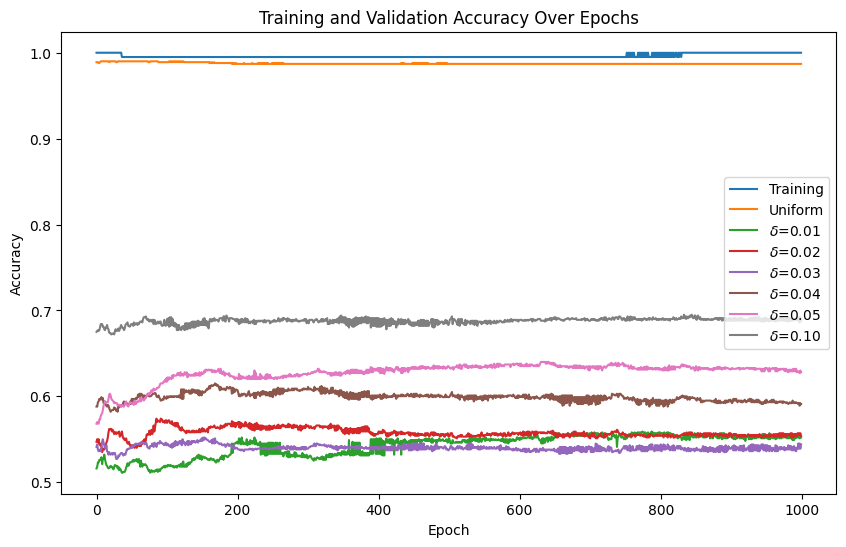

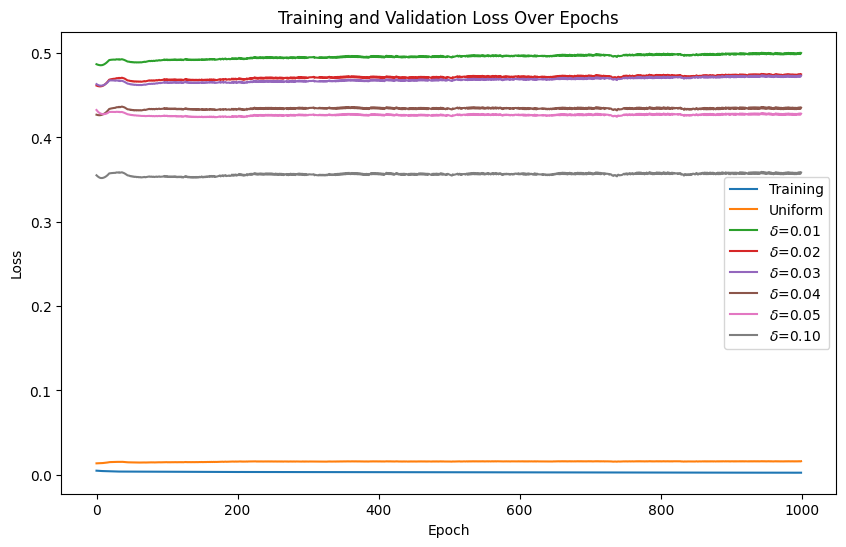

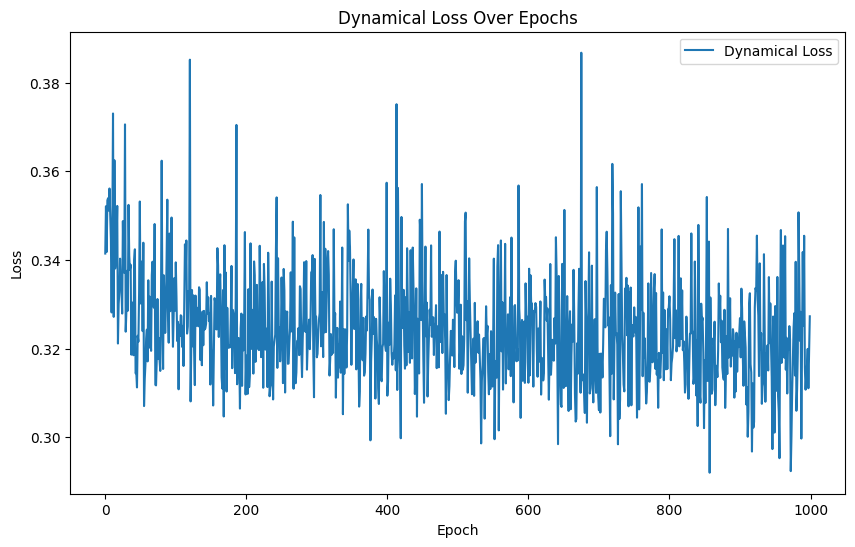

Accuracy: 1.0


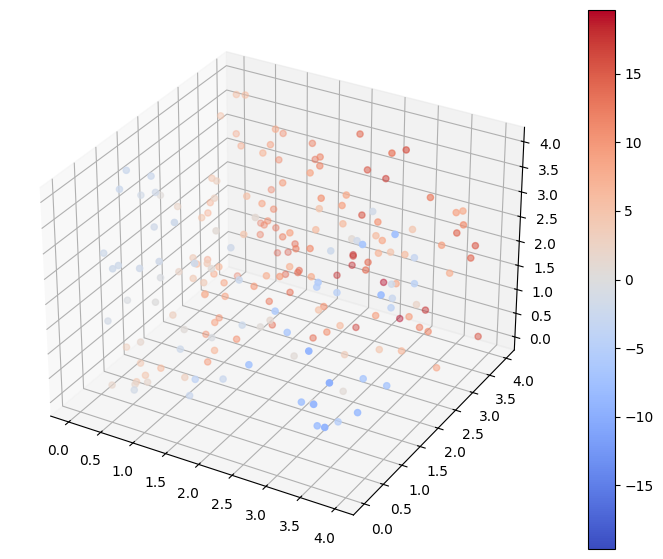

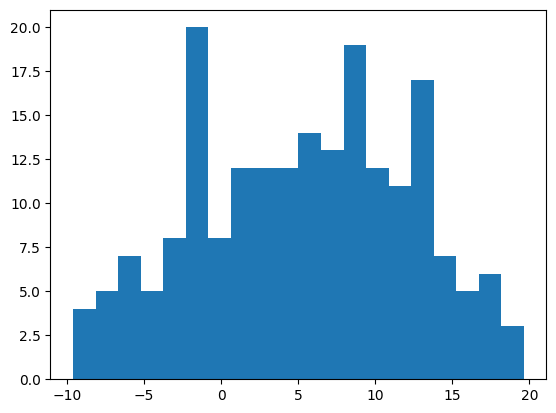

Accuracy: 0.9869999885559082


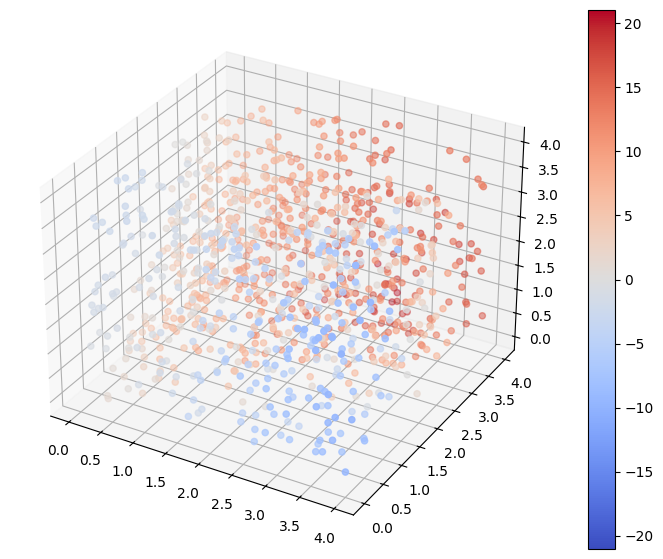

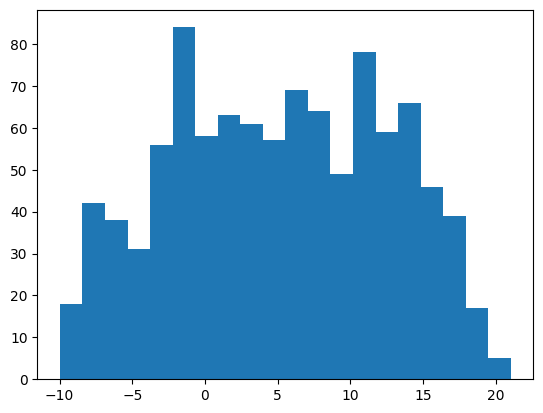

Accuracy: 0.5519999861717224


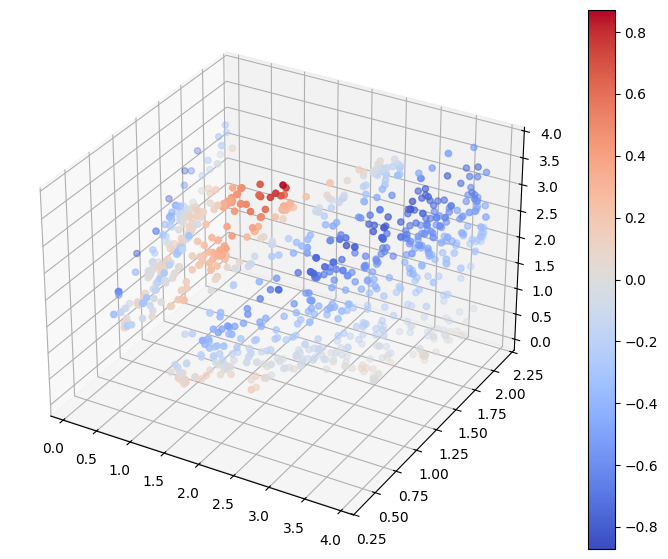

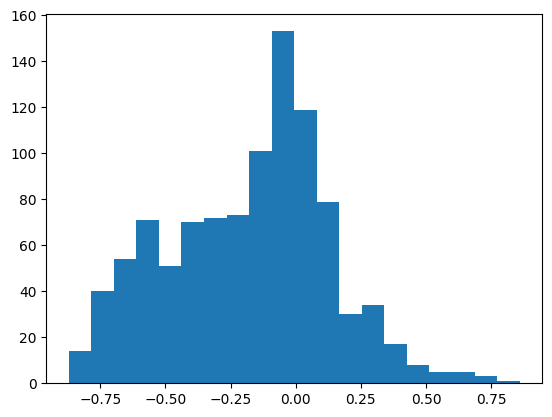

Accuracy: 0.5540000200271606


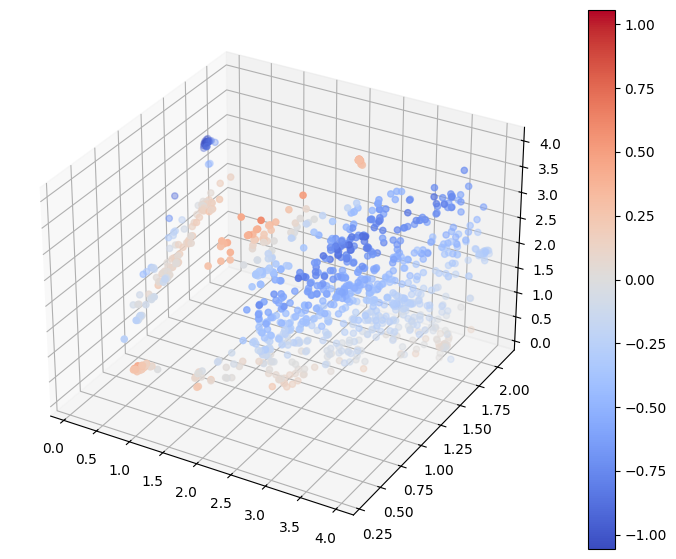

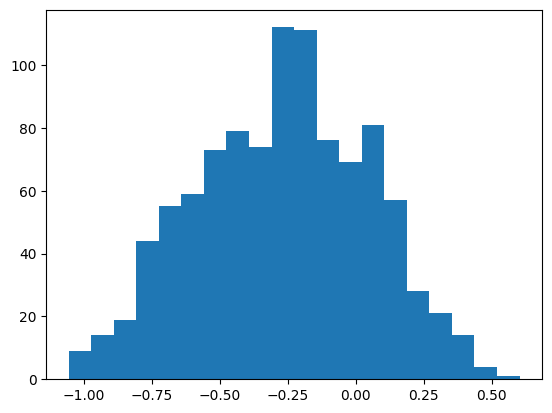

Accuracy: 0.5440000295639038


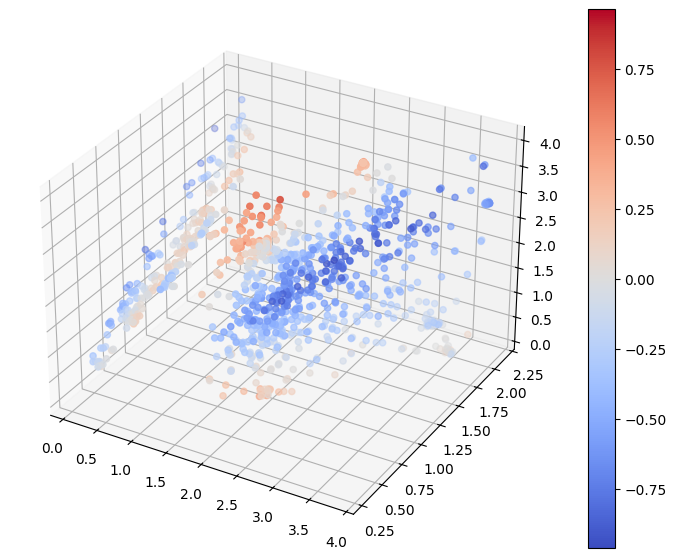

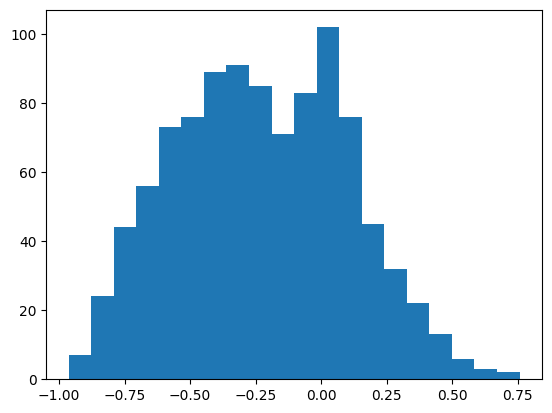

Accuracy: 0.5910000205039978


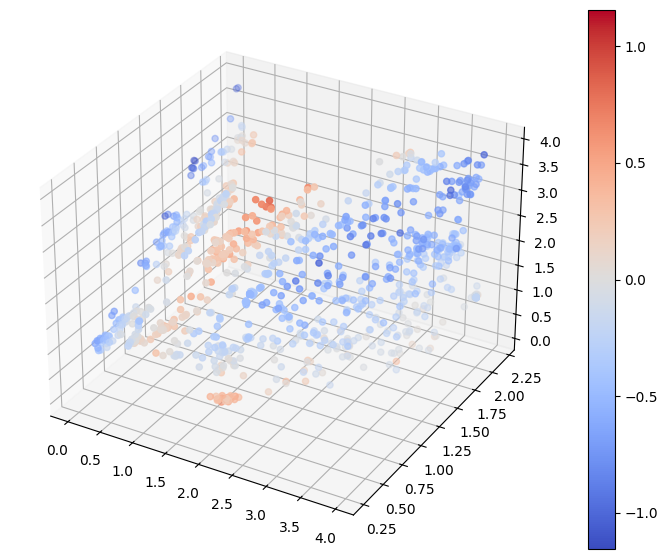

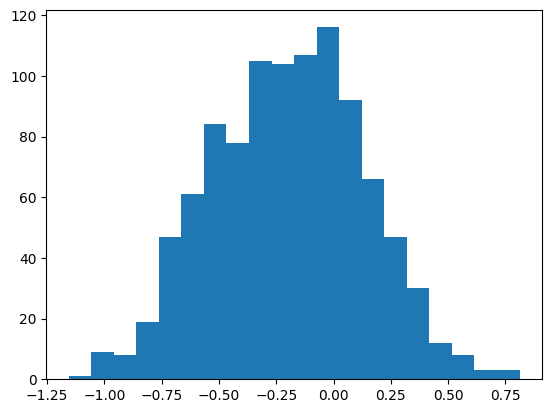

Accuracy: 0.628000020980835


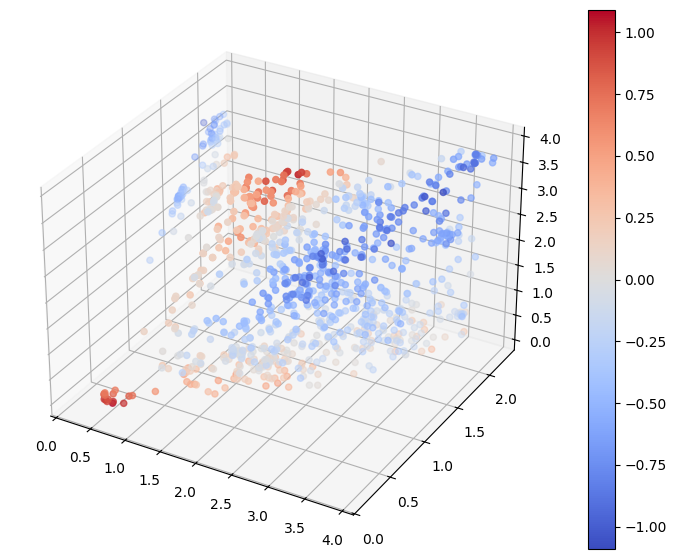

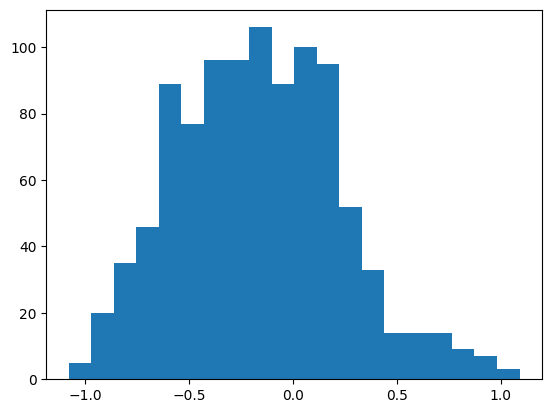

Accuracy: 0.6880000233650208


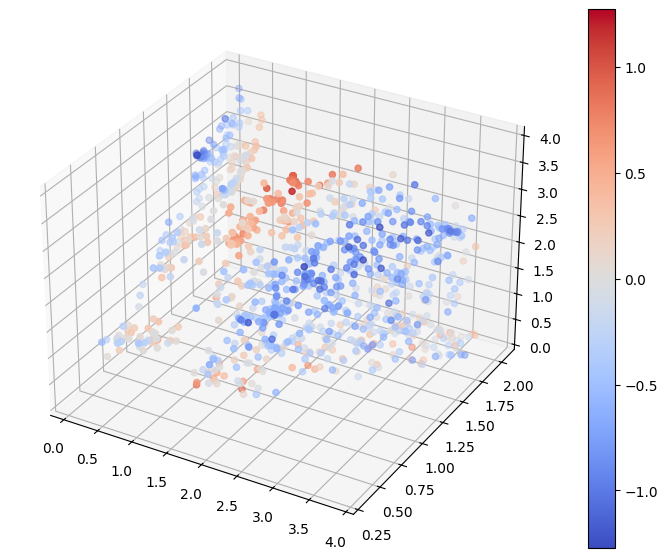

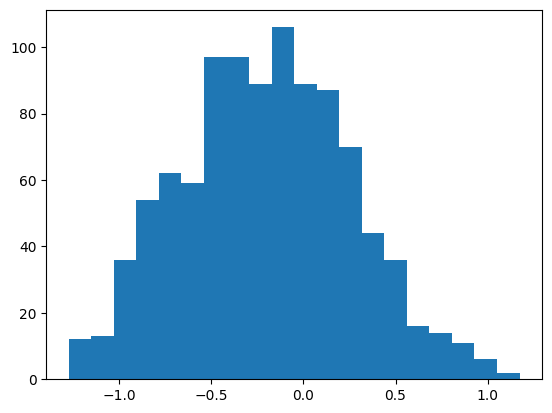

In [347]:
dataset_train_copy = deepcopy(dataset_train)
net_5 = deepcopy(net_hinge_square)
train_model_dynamical_adaptive(net_5, dataset_train_copy, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=len(dataset_train_copy), epochs=1000, lr=5e-5)

Accuracy: 0.9879999756813049


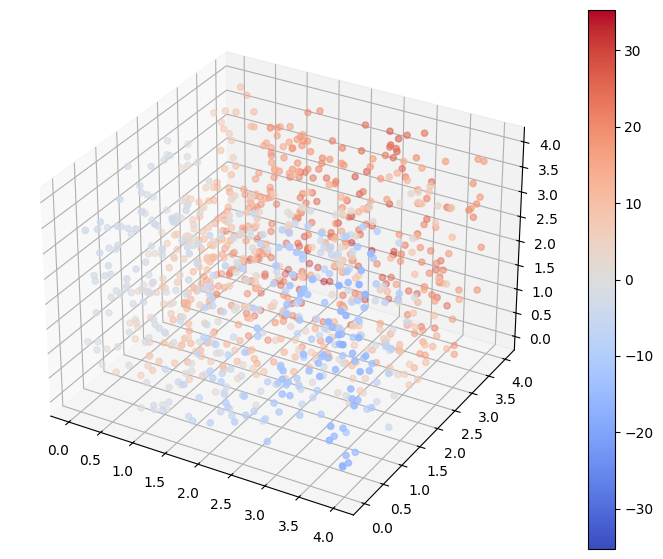

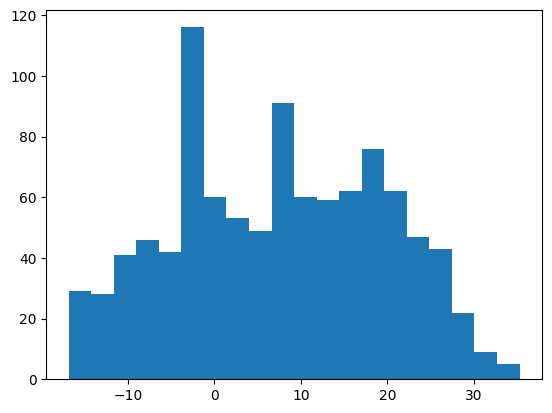

tensor(0.9880)

In [283]:
test_model(net_5, dataset_test_uniform)

Accuracy: 0.5419999957084656


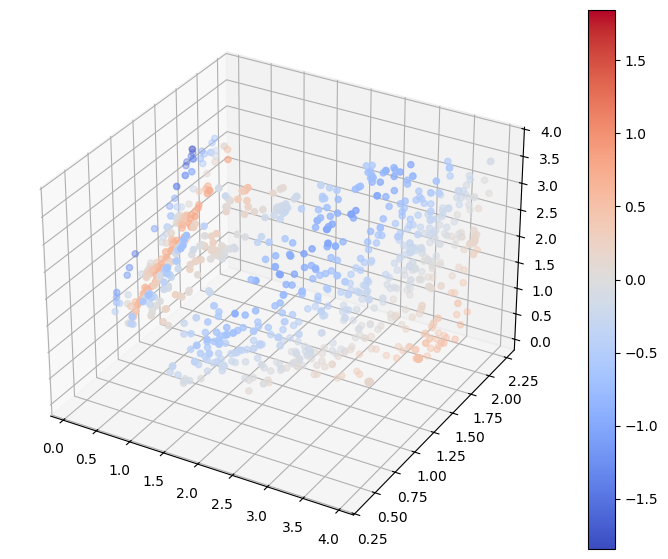

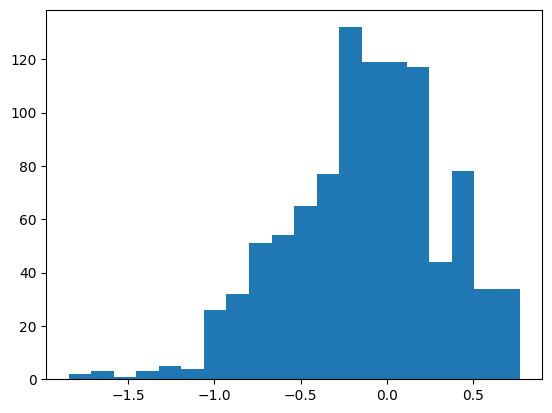

tensor(0.5420)

In [284]:
test_model(net_5, dataset_test_near_001)

Accuracy: 0.5590000152587891


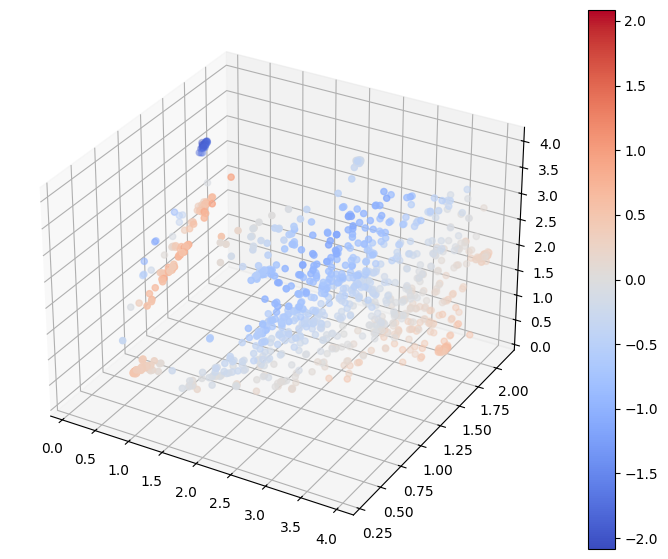

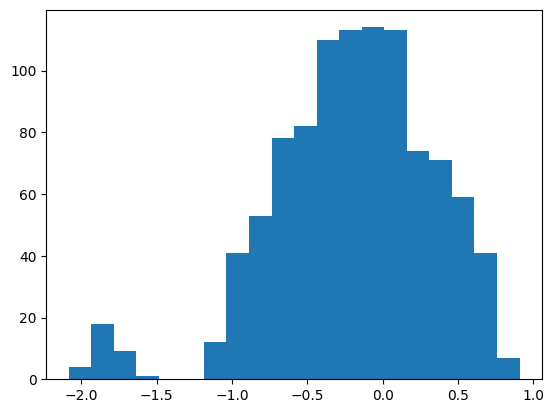

tensor(0.5590)

In [285]:
test_model(net_5, dataset_test_near_002)

Accuracy: 0.5619999766349792


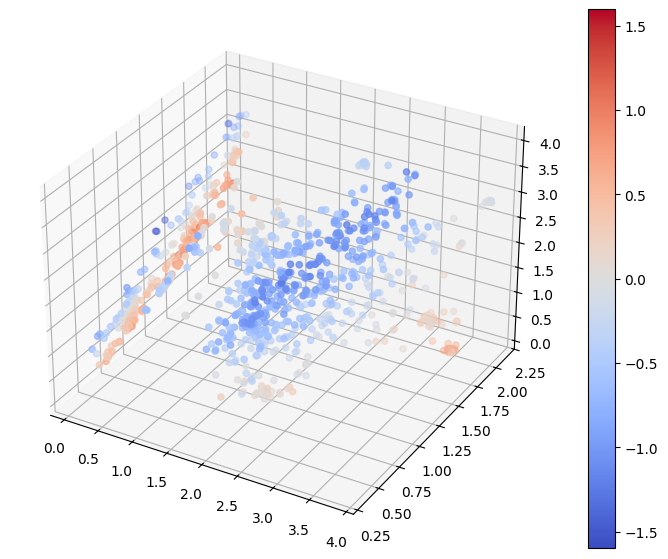

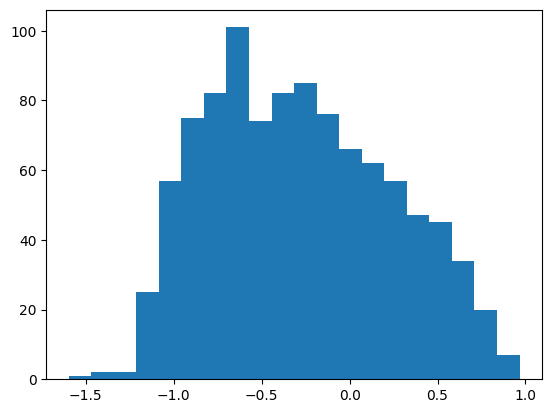

tensor(0.5620)

In [286]:
test_model(net_5, dataset_test_near_003)

Accuracy: 0.6240000128746033


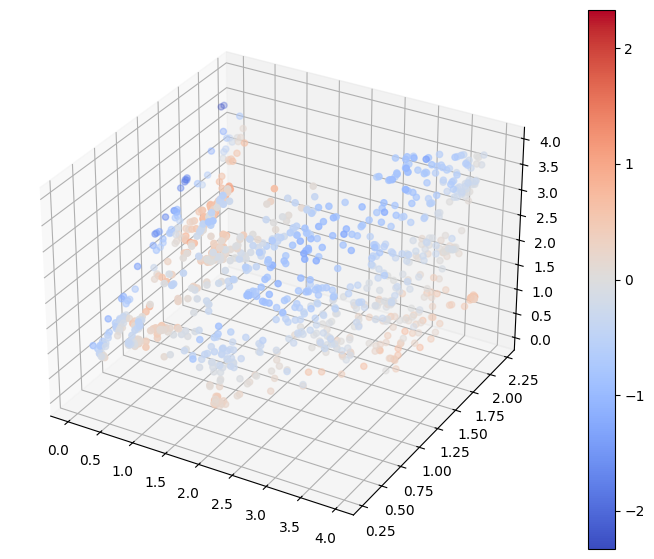

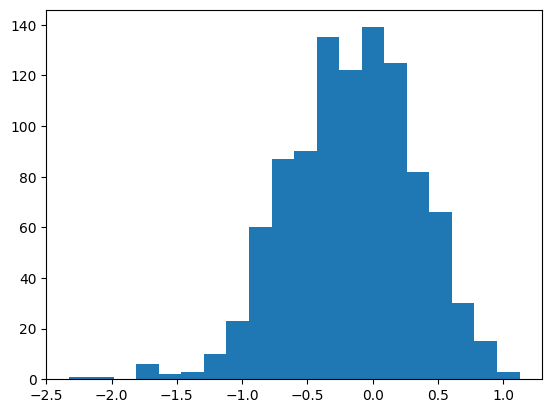

tensor(0.6240)

In [287]:
test_model(net_5, dataset_test_near_004)

Accuracy: 0.6359999775886536


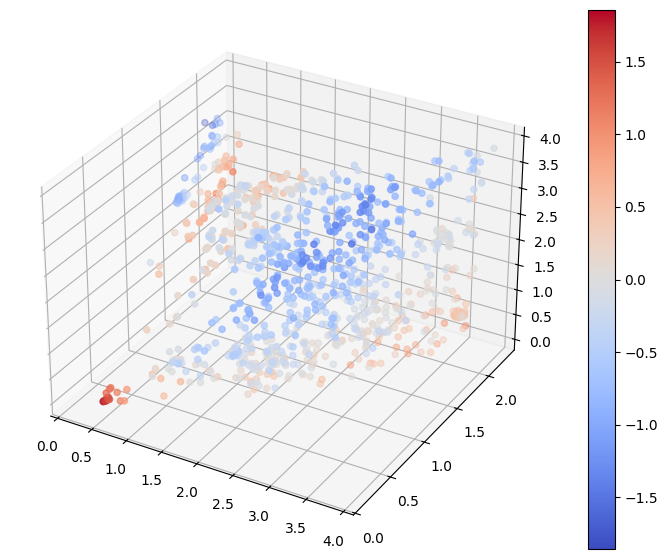

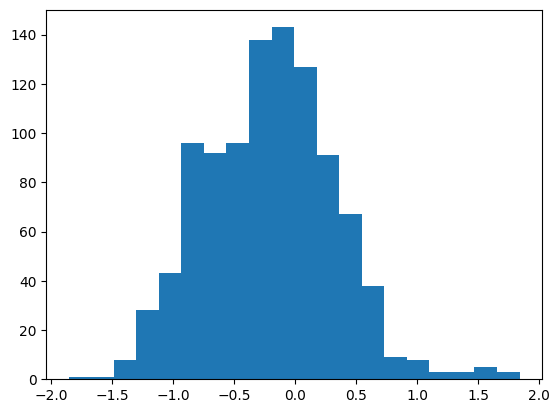

tensor(0.6360)

In [288]:
test_model(net_5, dataset_test_near_005)

Accuracy: 0.6729999780654907


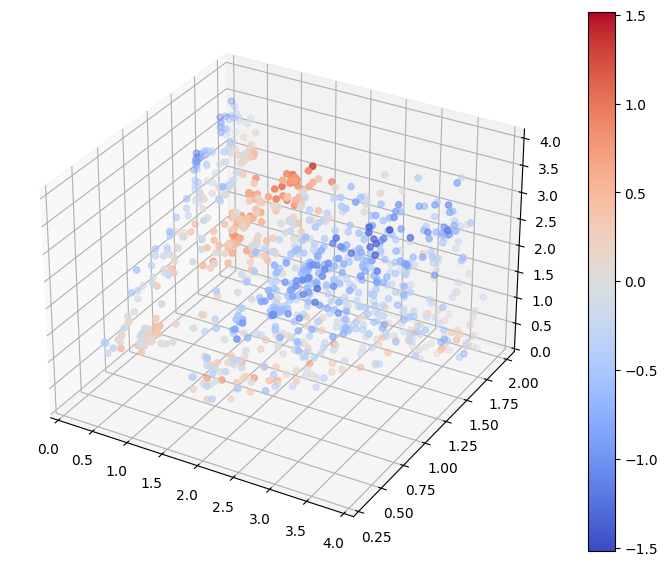

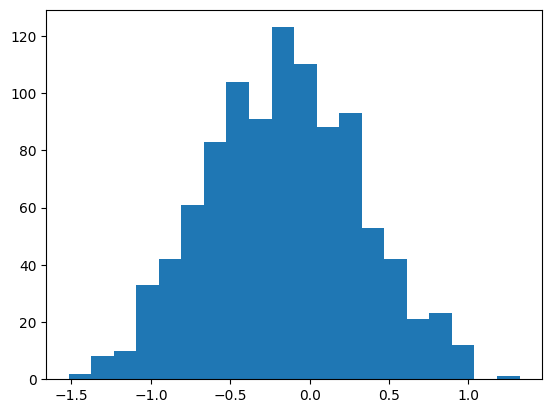

tensor(0.6730)

In [349]:
test_model(net_5, dataset_test_near_010)

Overall Training Progress:  20%|██        | 750/3750 [52:35<3:31:24,  4.23s/it, Training Accuracy=0.995, Validation1 Accuracy=0.987, Validation001 Accuracy=0.554, Validation002 Accuracy=0.553, Validation003 Accuracy=0.542, Validation004 Accuracy=0.596, Validation005 Accuracy=0.632, Validation010 Accuracy=0.685]

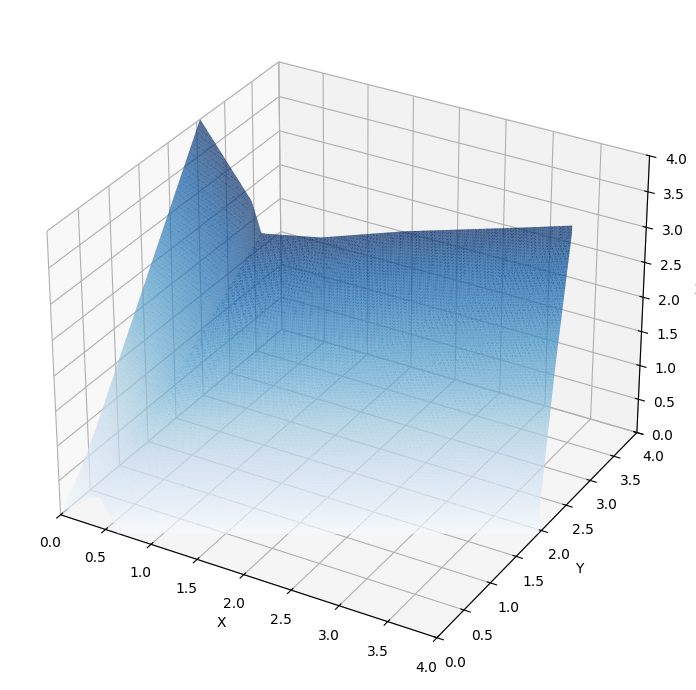

Overall Training Progress:  40%|████      | 1500/3750 [1:45:19<2:36:25,  4.17s/it, Training Accuracy=1, Validation1 Accuracy=0.988, Validation001 Accuracy=0.531, Validation002 Accuracy=0.57, Validation003 Accuracy=0.549, Validation004 Accuracy=0.62, Validation005 Accuracy=0.645, Validation010 Accuracy=0.705]     

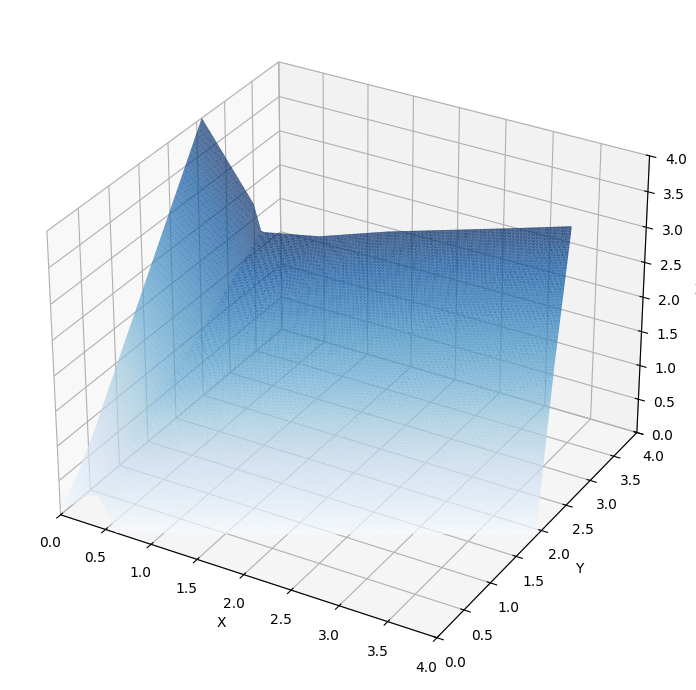

Overall Training Progress:  60%|██████    | 2250/3750 [2:39:35<1:48:35,  4.34s/it, Training Accuracy=1, Validation1 Accuracy=0.989, Validation001 Accuracy=0.543, Validation002 Accuracy=0.582, Validation003 Accuracy=0.544, Validation004 Accuracy=0.644, Validation005 Accuracy=0.652, Validation010 Accuracy=0.731]

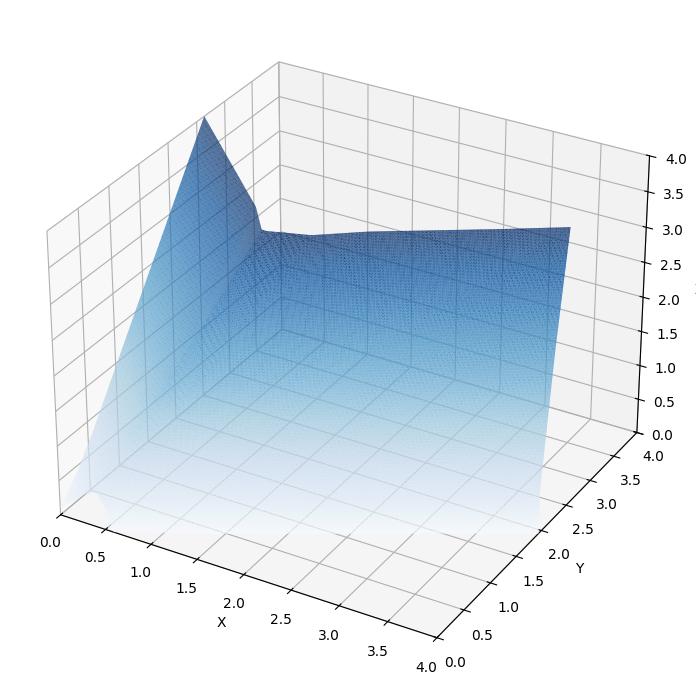

Overall Training Progress:  80%|████████  | 3000/3750 [3:32:49<52:38,  4.21s/it, Training Accuracy=1, Validation1 Accuracy=0.986, Validation001 Accuracy=0.539, Validation002 Accuracy=0.569, Validation003 Accuracy=0.555, Validation004 Accuracy=0.65, Validation005 Accuracy=0.643, Validation010 Accuracy=0.767]   

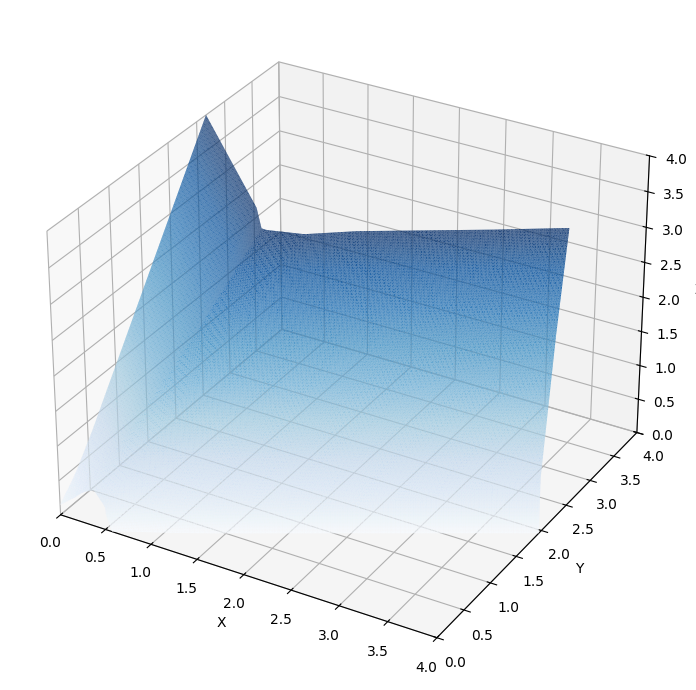

Overall Training Progress: 100%|██████████| 3750/3750 [4:25:39<00:00,  4.26s/it, Training Accuracy=1, Validation1 Accuracy=0.99, Validation001 Accuracy=0.546, Validation002 Accuracy=0.567, Validation003 Accuracy=0.568, Validation004 Accuracy=0.633, Validation005 Accuracy=0.639, Validation010 Accuracy=0.773]  

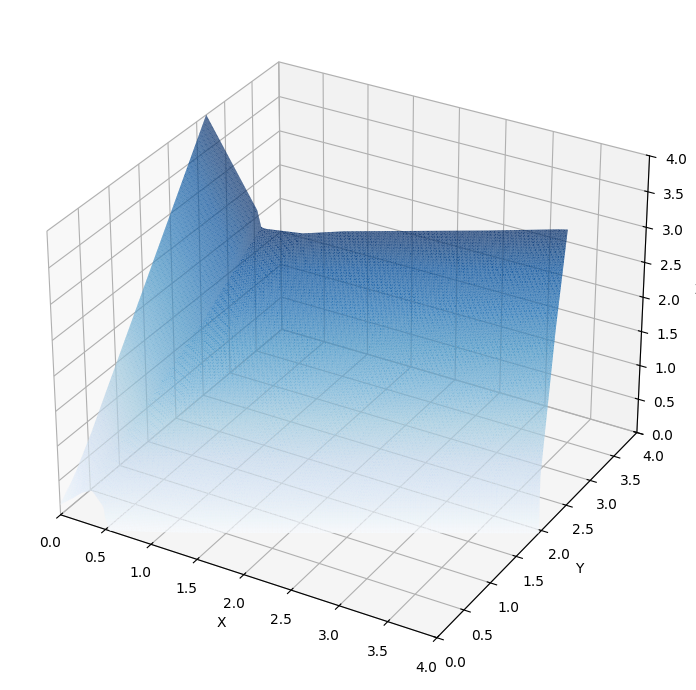

Overall Training Progress: 100%|██████████| 3750/3750 [4:25:43<00:00,  4.25s/it, Training Accuracy=1, Validation1 Accuracy=0.99, Validation001 Accuracy=0.546, Validation002 Accuracy=0.567, Validation003 Accuracy=0.568, Validation004 Accuracy=0.633, Validation005 Accuracy=0.639, Validation010 Accuracy=0.773]


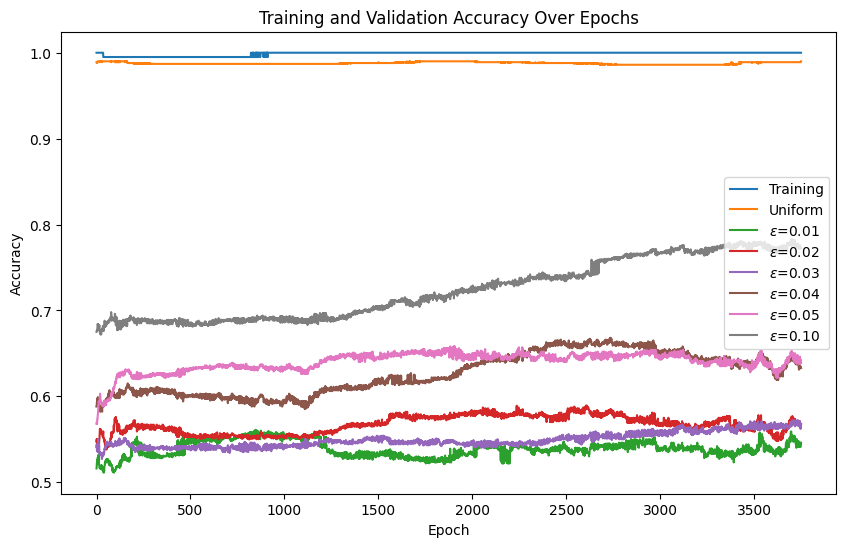

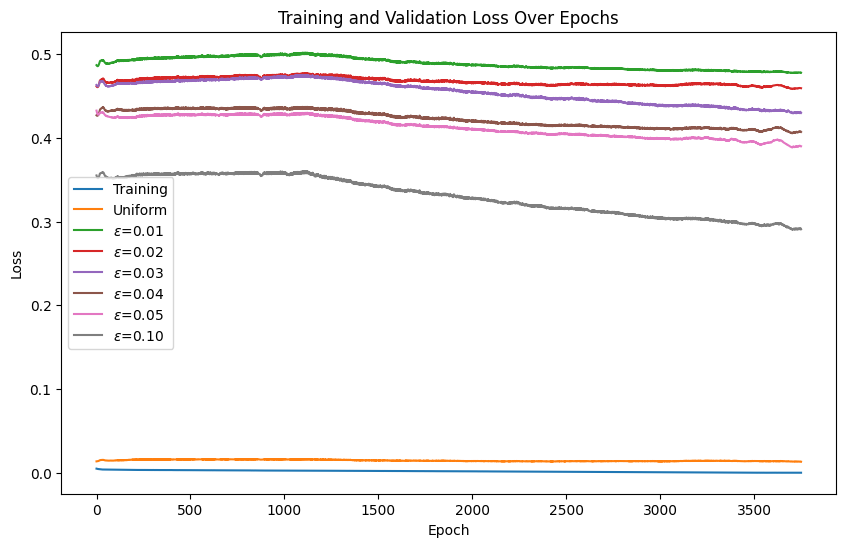

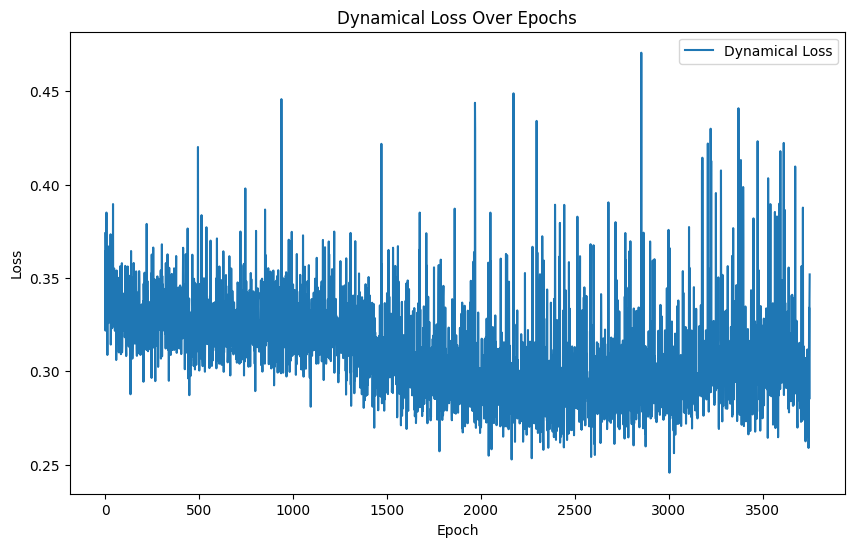

In [498]:
dataset_train_copy = deepcopy(dataset_train)
net_6 = deepcopy(net_hinge_square)
train_model_dynamical_adaptive(net_6, dataset_train_copy, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=len(dataset_train_copy), epochs=3750, lr=5e-5)

Accuracy: 0.9879999756813049


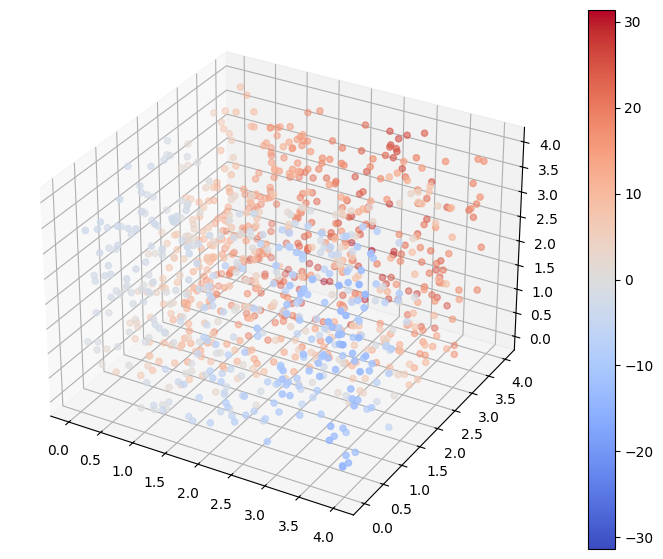

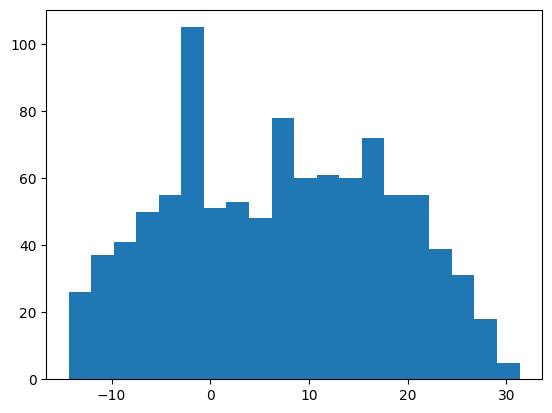

tensor(0.9880)

In [499]:
test_model(net_6, dataset_test_uniform)

Accuracy: 0.5509999990463257


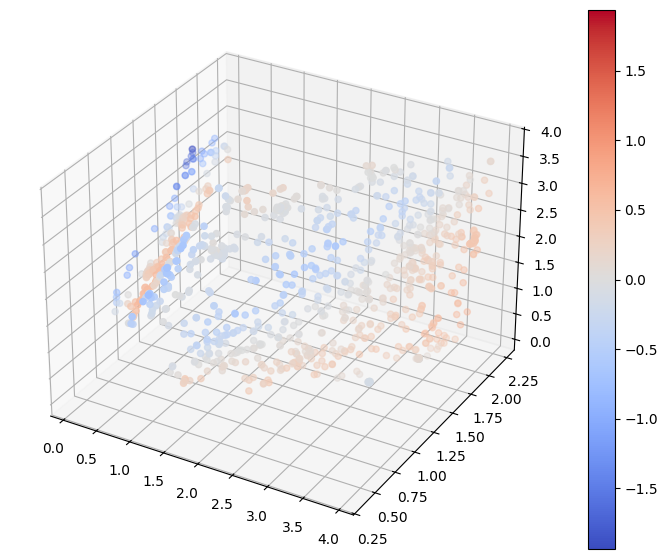

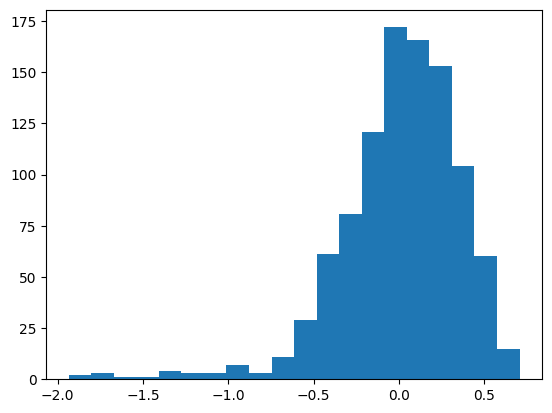

tensor(0.5510)

In [500]:
test_model(net_6, dataset_test_near_001)

Accuracy: 0.5400000214576721


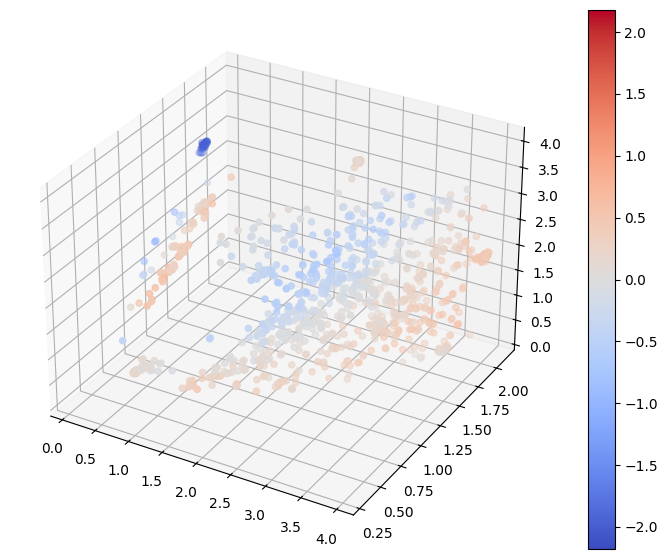

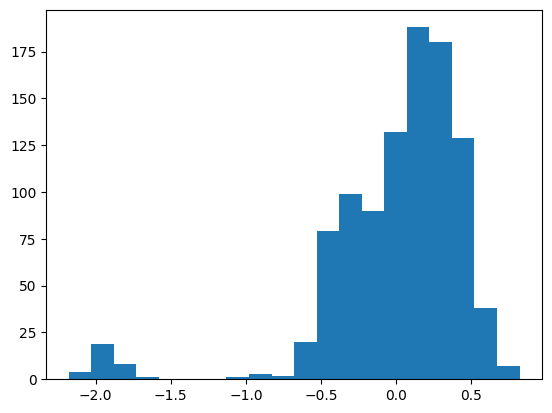

tensor(0.5400)

In [501]:
test_model(net_6, dataset_test_near_002)

Accuracy: 0.597000002861023


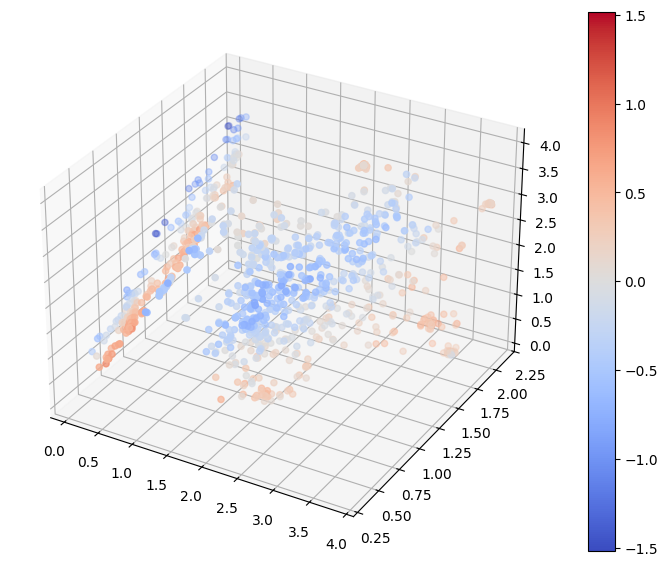

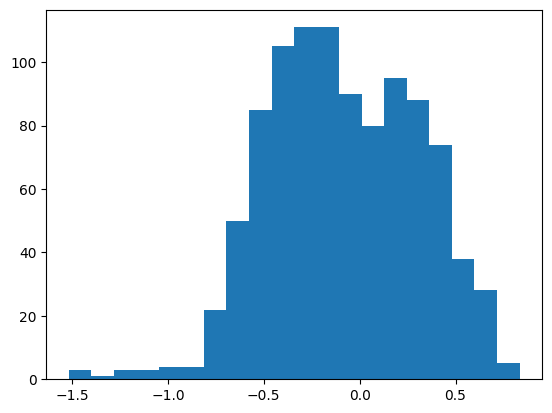

tensor(0.5970)

In [502]:
test_model(net_6, dataset_test_near_003)

Accuracy: 0.6660000085830688


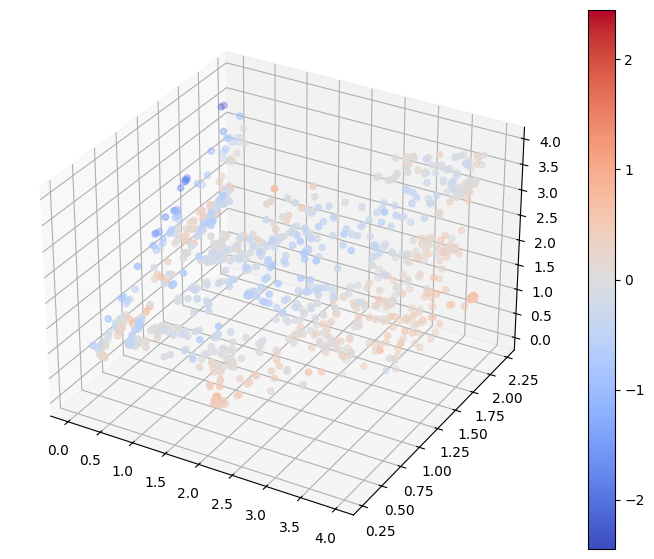

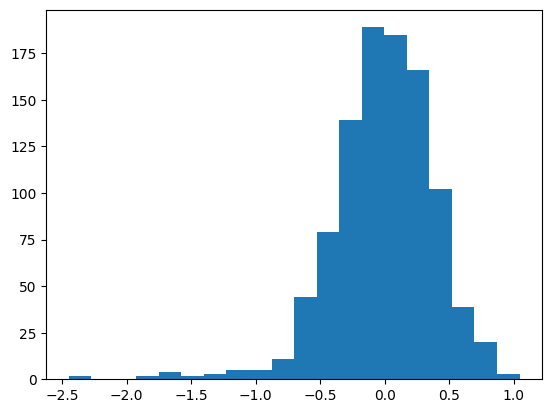

tensor(0.6660)

In [503]:
test_model(net_6, dataset_test_near_004)

Accuracy: 0.6449999809265137


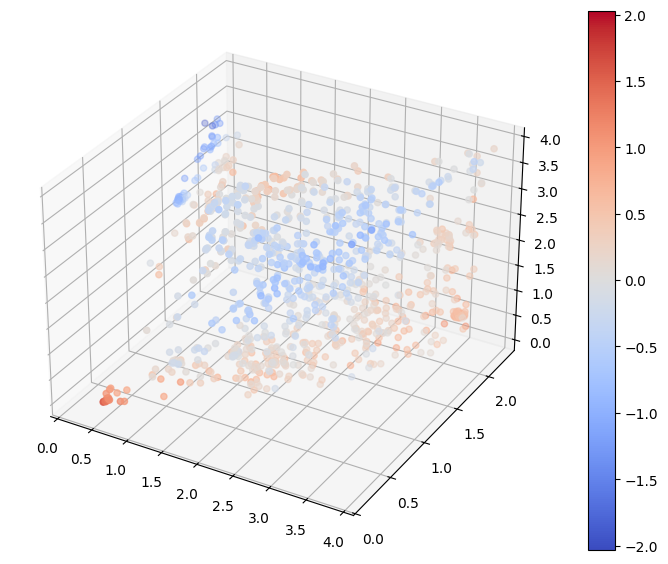

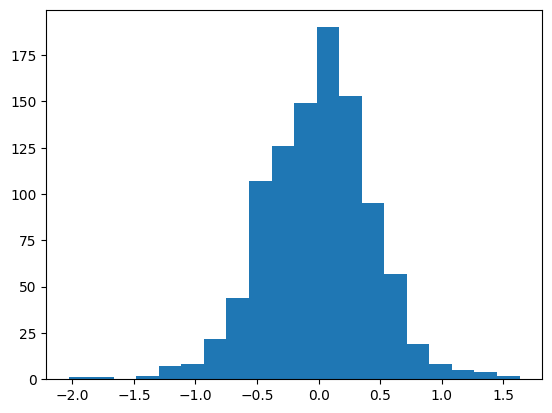

tensor(0.6450)

In [504]:
test_model(net_6, dataset_test_near_005)

Accuracy: 0.7649999856948853


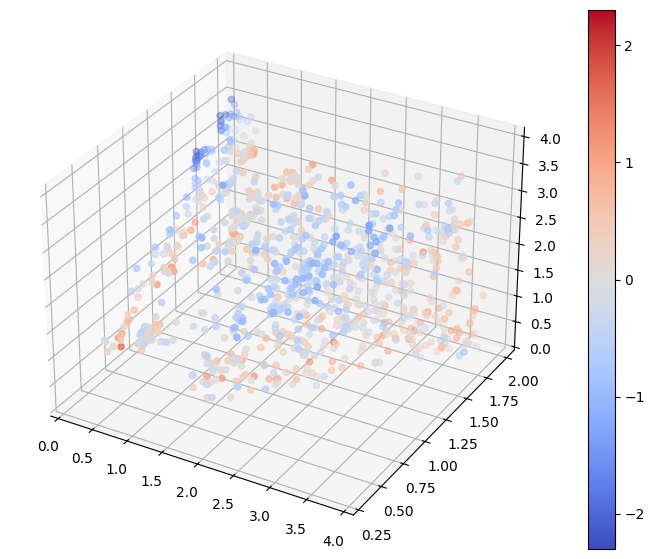

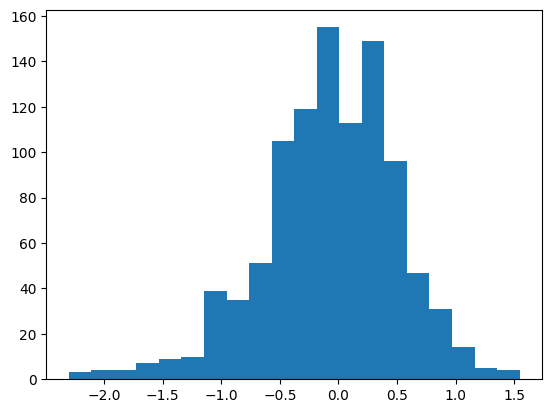

tensor(0.7650)

In [505]:
test_model(net_6, dataset_test_near_010)